#### Import all the required packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

C:\Users\Z004R5VB\Anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\Z004R5VB\Anaconda3\lib\site-packages\numpy\.libs\libopenblas.FB5AE2TYXYH2IJRDKGDGQ3XBKLKTF43H.gfortran-win_amd64.dll
C:\Users\Z004R5VB\Anaconda3\lib\site-packages\numpy\.libs\libopenblas64__v0.3.23-246-g3d31191b-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
# Read the data
df = pd.read_csv(r'D:\bridgestone_mithul\Interview_Challenges\Detect_obstacles_in_roads_from_accelerometer_data\Data\acceleration_data_in_bilbao_SP.csv')

#### Data Exploration

In [3]:
df.shape

(262443, 13)

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 262443 entries, 0 to 262442
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   time              262443 non-null  object 
 1   acc_x             262443 non-null  float64
 2   acc_y             262443 non-null  float64
 3   acc_z             262443 non-null  float64
 4   speed             262443 non-null  float64
 5   latitude          262443 non-null  float64
 6   longitude         262443 non-null  float64
 7   heading           262443 non-null  float64
 8   road_speed_limit  262443 non-null  int64  
 9   vehicle_make      262443 non-null  object 
 10  vehicle_model     262443 non-null  object 
 11  vehicle_type      262443 non-null  object 
 12  road_type         262443 non-null  object 
dtypes: float64(7), int64(1), object(5)
memory usage: 26.0+ MB


In [57]:
df.isnull().sum()

time                0
acc_x               0
acc_y               0
acc_z               0
speed               0
latitude            0
longitude           0
heading             0
road_speed_limit    0
vehicle_make        0
vehicle_model       0
vehicle_type        0
road_type           0
dtype: int64

##### Observations:

1. Time column is an object type hence needs to converted to datetime type
2. vehicle_make, model, type and road_type are the categorical columns

In [44]:
df.tail()

,time,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,vehicle_make,vehicle_model,vehicle_type,road_type
262438,2022-09-29 16:01:47.128,-0.015,-0.108,0.986,67.6,43.214165,-2.884899,24.640694,80,MAN,TGX,truck,SECONDARY_ROAD
262439,2022-09-29 16:01:47.228,-0.011,-0.057,1.005,67.6,43.214180,-2.884889,25.098776,80,MAN,TGX,truck,SECONDARY_ROAD
262440,2022-09-29 16:01:47.328,0.001,-0.068,0.991,67.6,43.214195,-2.884879,25.340712,80,MAN,TGX,truck,SECONDARY_ROAD
262441,2022-09-29 16:01:47.428,-0.027,-0.097,0.985,67.6,43.214210,-2.884869,25.629484,80,MAN,TGX,truck,SECONDARY_ROAD
262442,2022-09-29 16:01:47.528,0.000,-0.061,0.994,67.6,43.214226,-2.884859,26.041390,80,MAN,TGX,truck,SECONDARY_ROAD


In [4]:
# Get the central tendency measures of all numerical columns
df.describe(percentiles = [0.05, 0.1,0.2,0.25, 0.5,0.75, 0.9,0.99])

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit
count,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000
mean,-0.005591,-0.001974,1.012184,80.967359,42.805124,-3.529438,173.051511,104.127068
std,0.037854,0.040085,0.058322,18.806381,0.287253,0.495934,105.751084,23.590956
min,-0.519000,-0.295000,0.144000,0.000000,42.356133,-4.242803,0.000000,30.000000
5%,-0.064000,-0.063000,0.923000,32.200000,42.377945,-4.183028,12.616689,50.000000
10%,-0.047000,-0.044000,0.948000,54.800000,42.425538,-4.131536,29.970341,60.000000
20%,-0.031000,-0.027000,0.973000,78.000000,42.521984,-4.076939,55.246794,90.000000
25%,-0.025000,-0.022000,0.982000,82.000000,42.573081,-4.056762,71.179503,90.000000
50%,-0.005000,-0.001000,1.011000,89.500000,42.763565,-3.639542,179.566180,120.000000
75%,0.016000,0.019000,1.042000,90.200000,43.044025,-2.929246,250.820230,120.000000


##### Observations:

1. All the features are normally distributed except for road_speed_limit due to the fact that the average is around 104 km/h where as the median is around 120 km/h hence the distribution would be skewed.
2. Road_Speed_limit seems to have more than 50% of the data equal to 120 km/h so mostly this indicates that the vehicle was driven on a NH.

In [5]:
df['road_type'].value_counts()

MOTORWAY                          189685
MAJOR_ROAD_OF_HIGH_IMPORTANCE      44434
SECONDARY_ROAD                     18611
MAJOR_ROAD                          4991
LOCAL_ROAD_OF_MAJOR_IMPORTANCE      3194
CONNECTING_ROAD                     1138
DESTINATION_ROAD                     390
Name: road_type, dtype: int64

In [6]:
df['vehicle_make'].value_counts()

MAN    262443
Name: vehicle_make, dtype: int64

In [48]:
df['vehicle_model'].value_counts()

TGX    262443
Name: vehicle_model, dtype: int64

In [49]:
df['vehicle_type'].value_counts()

truck    262443
Name: vehicle_type, dtype: int64

Observations:
1. Vehicle make, model and type all belongs to MAN trucks hence there is no need of these columns, the key takeaway from these columns is that these measurements were done for a truck

In [50]:
# find out speed limits and average speed for each road type
# find out the acceleration and deceleration patterns based on the acc_x, acc_y, acc_z

In [7]:
# group by road type and agg by road_Speed_limit and vehicle speed
grouped_df = df.groupby(['road_type'])[['road_speed_limit','speed']].mean()

In [8]:
grouped_df

,road_speed_limit,speed
road_type,,
CONNECTING_ROAD,53.585237,27.594552
DESTINATION_ROAD,74.615385,69.853846
LOCAL_ROAD_OF_MAJOR_IMPORTANCE,32.654978,15.124045
MAJOR_ROAD,67.749950,21.403066
MAJOR_ROAD_OF_HIGH_IMPORTANCE,89.436468,81.875082
MOTORWAY,114.513114,86.733534
SECONDARY_ROAD,59.075815,50.800838


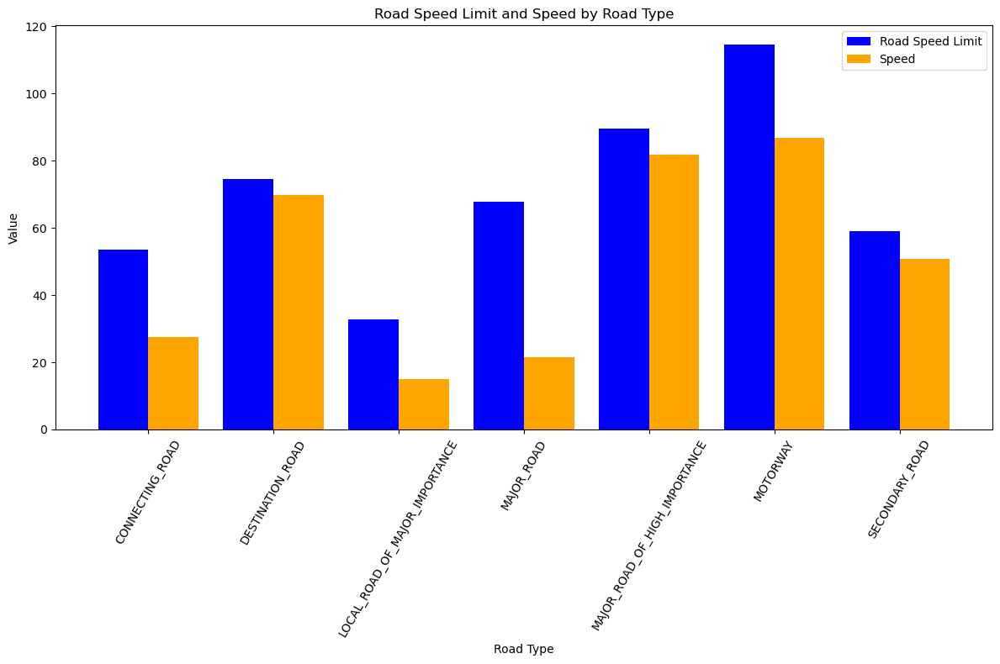

In [9]:
import matplotlib.pyplot as plt

# Assuming you have the 'grouped_df' DataFrame with the data

# Create a bar plot with explicit tick positions
plt.figure(figsize=(12, 8))

x = range(len(grouped_df))
bar_width = 0.4  # Adjust this value to control the gap between the bars

plt.bar(x, grouped_df['road_speed_limit'], width=bar_width, label='Road Speed Limit', color='blue')
plt.bar([i + bar_width for i in x], grouped_df['speed'], width=bar_width, label='Speed', color='orange')

plt.xlabel('Road Type')
plt.ylabel('Value')
plt.title('Road Speed Limit and Speed by Road Type')
plt.xticks([i + bar_width / 2 for i in x], grouped_df.index, rotation = 60)
plt.legend()
plt.tight_layout()

plt.show()


Observations:
  1. Road types namely connecting road, local road and secondary road has lower speed limits and corresponding average speed observed is almost half of the road_speed_limit
  2. While road types like destination road, major road and motorway have higher speed limits and corresponding average speed observed is closer to the speed limits.
  3. Road types motor way and major road have higher speed limits and average vehicle speed, and this is an indication that these roads might come under the category of expressways due to which these roads might not have speed bumps

In [10]:
import plotly.express as px

In [11]:
# Plot the trip trajectory
sampled_df = df.copy()

fig = px.scatter_mapbox(sampled_df,
                        lat='latitude',
                        lon='longitude',
                        hover_name='time',
                        color='road_type',
                        #size='speed',
                        #height=500,
                        mapbox_style='open-street-map')

fig.show()

##### Observations:
    1.Majority of the time almost 70-80% of the time the truck was plying in the motorway whose speed limit was around 114 kmph.
    2.There was a stretch between Aguilar De Campo and Burgos where majority of this portion has major road whose speed limit was around 90 kmph.

Comments:
   - As per NACTO standards there are certain criteria's based on which speed humps are constructed and as per the latest guidelines.
   - "https://nacto.org/docs/usdg/updated_design_guidelines_for_the_design_and_application_of_speed_humps_parkhill.pdf" - NACTO Standard.
   - According to wiki page https://en.wikipedia.org/wiki/Speed_bump speed bumps cannot be constructed on high speed express ways hence the prpbability of finding a speed bump in our dataset where road type is motor way and major road whose average speeds were beyond 70 kmph is almost zero.

#### Data correctness checks

In [12]:
# Accelaration is +/- but speed is zero
df_speed_zero = df[(df['acc_x']>0) & (df['speed']==0)]

In [13]:
df_speed_zero.describe()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit
count,102.00000,102.000000,102.000000,102.0,102.000000,102.000000,102.000000,102.000000
mean,0.01402,0.012039,1.011157,0.0,43.278985,-3.298568,259.490196,62.941176
std,0.01523,0.015955,0.003127,0.0,0.058395,0.577706,40.393545,30.002912
min,0.00100,-0.012000,0.993000,0.0,43.234370,-4.076939,219.000000,30.000000
25%,0.00200,0.000000,1.010000,0.0,43.234450,-4.076939,219.000000,30.000000
50%,0.01000,0.003000,1.011000,0.0,43.237460,-2.875894,245.000000,90.000000
75%,0.01500,0.032000,1.013000,0.0,43.357647,-2.871810,312.000000,90.000000
max,0.04500,0.038000,1.021000,0.0,43.357647,-2.871696,314.000000,90.000000


In [14]:
# Create a boolean mask for the conditions
condition_1 = (df['acc_x'] > 0) & (df['speed'] == 0)

# Use the negation (~) to exclude rows that satisfy the conditions
filtered_df = df[~condition_1]

In [15]:
# Acceleration is zero but speed exists
condition_2 = (filtered_df['acc_x']==0) & (filtered_df['acc_y']==0) & (filtered_df['acc_z']==0) & (filtered_df['speed']>0)

# Use the negation (~) to exclude rows that satisfy the conditions
filtered_df = filtered_df[~condition_2]

<Figure size 1200x800 with 0 Axes>

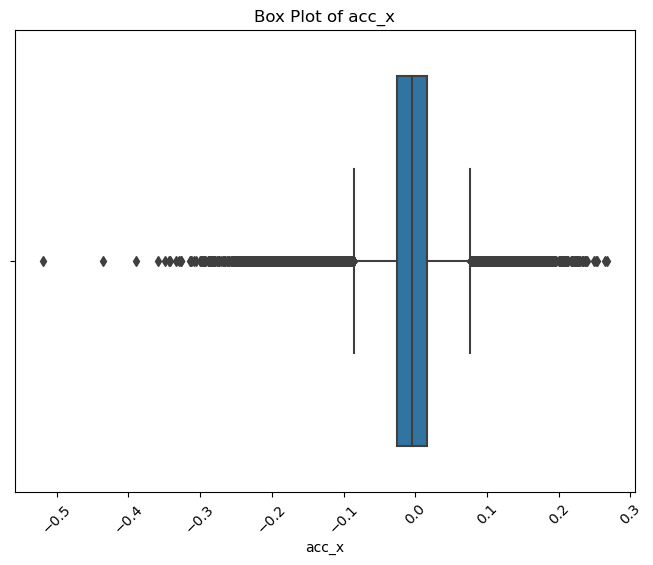

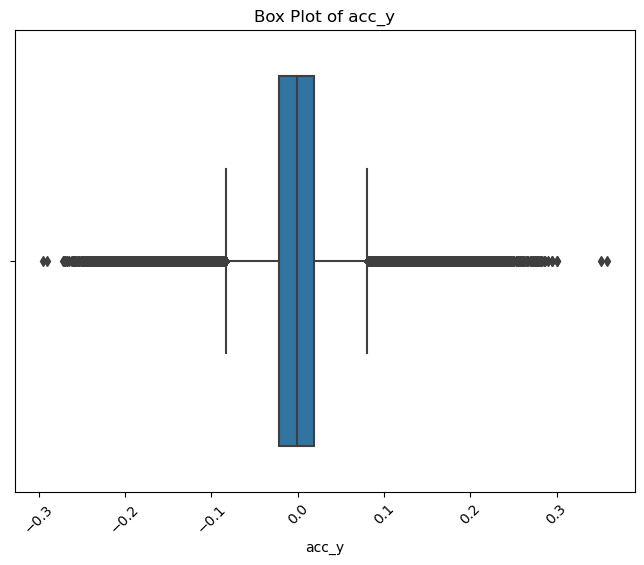

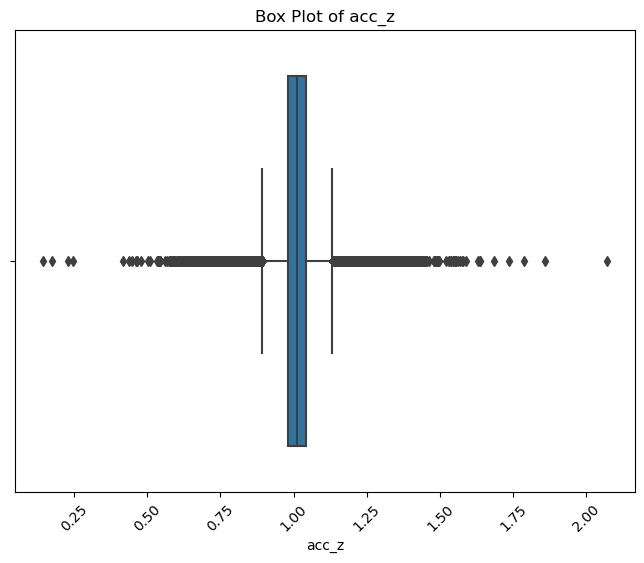

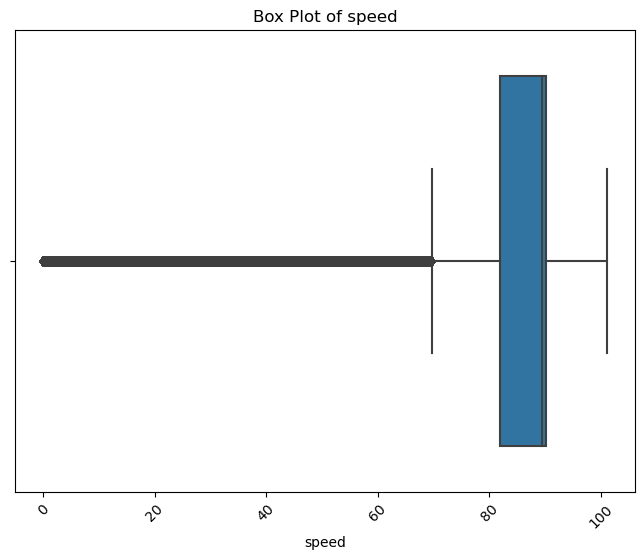

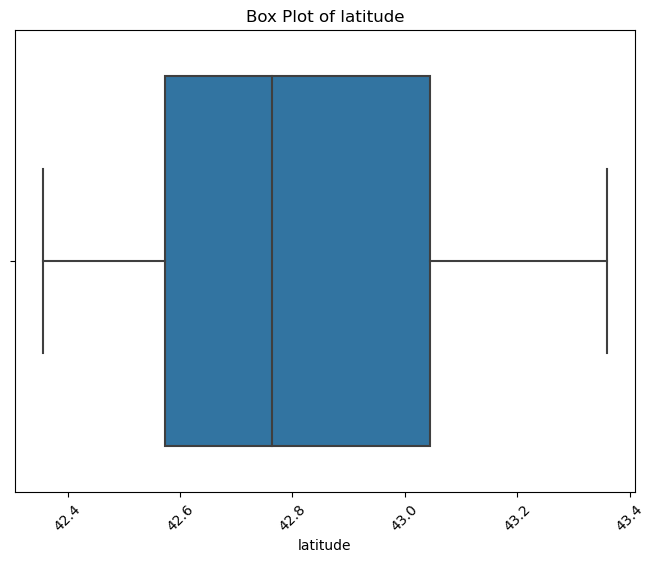

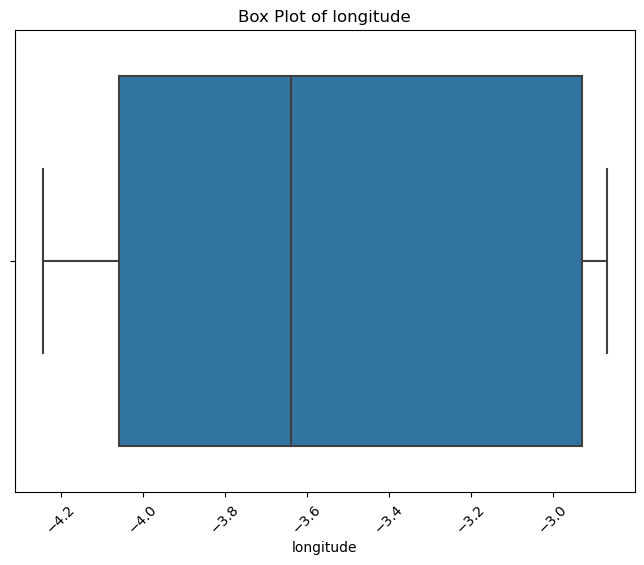

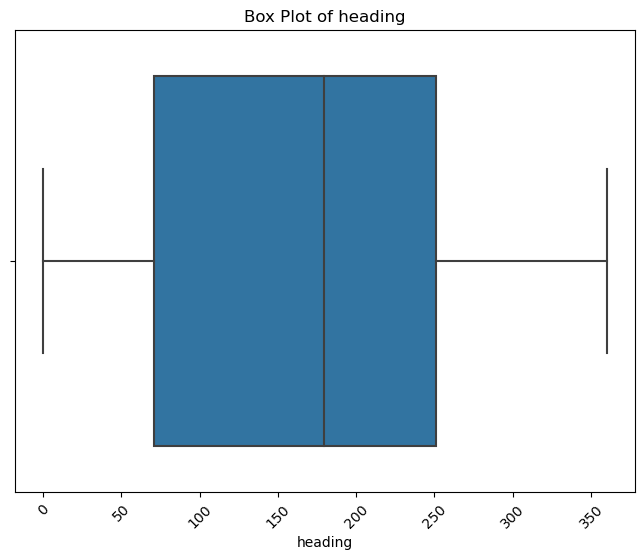

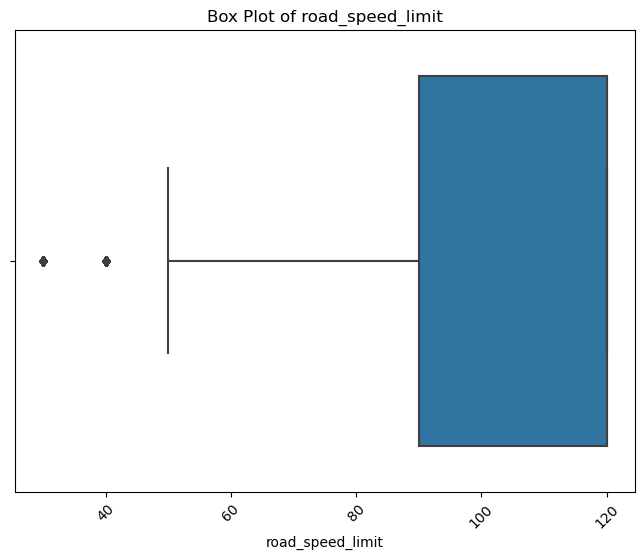

In [70]:
# Check if there are any outliers in the filtered dataframe

import seaborn as sns

# Get a list of numerical column names
numerical_columns = filtered_df.select_dtypes(include=['number']).columns

# Set the figure size and create individual box plots
plt.figure(figsize=(12, 8))

for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=df, x=column)
    plt.title(f'Box Plot of {column}')
    plt.xticks(rotation=45)
    plt.show()

In [16]:
import matplotlib.pyplot as plt

def plot_acceleration_over_time(df, x_col, y_col, title, x_label, y_label):
    """
    Create a line chart to visualize acceleration values over time.

    Parameters:
    - df: DataFrame containing the data.
    - x_col: Name of the column for the x-axis (e.g., 'timestamp').
    - y_col: Name of the column for the y-axis (e.g., 'acceleration').
    - title: Title of the chart.
    - x_label: Label for the x-axis.
    - y_label: Label for the y-axis.
    """

    plt.figure(figsize=(12, 6))
    
    # Sort the data by the x-axis column if needed
    if df[x_col].dtype == 'datetime64[ns]':
        df = df.sort_values(by=x_col)

    # Create a line chart for acceleration values over time
    plt.plot(df[x_col], df[y_col], color='blue', label=y_col)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

In [17]:
# Convert time column to datetime format before visualizing distribution of acceleration
filtered_df['time'] = pd.to_datetime(filtered_df['time'])

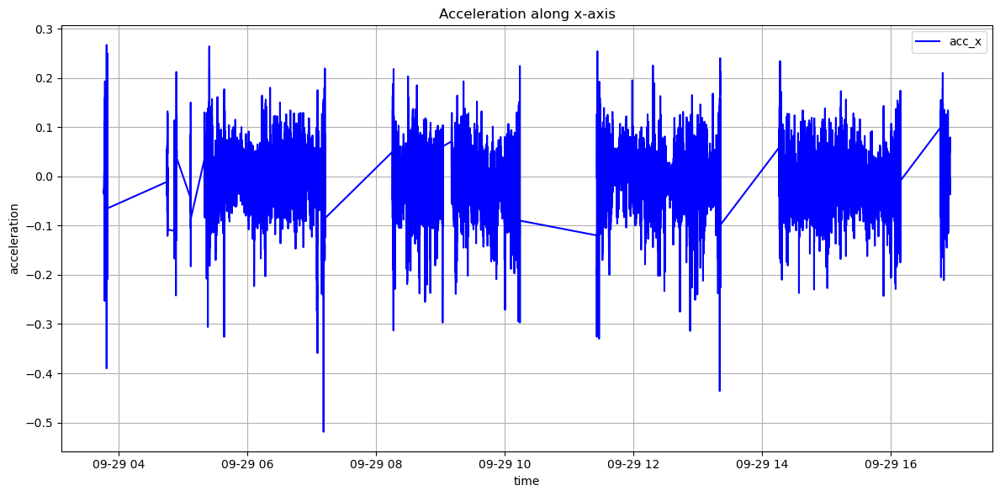

In [18]:
plot_acceleration_over_time(filtered_df, 'time', 'acc_x', 'Acceleration along x-axis', 'time', 'acceleration')

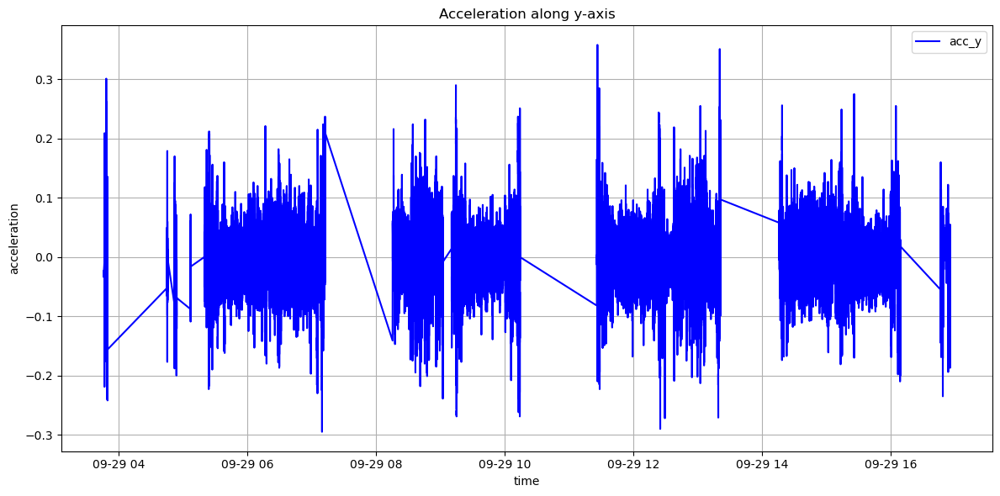

In [80]:
plot_acceleration_over_time(filtered_df, 'time', 'acc_y', 'Acceleration along y-axis', 'time', 'acceleration')

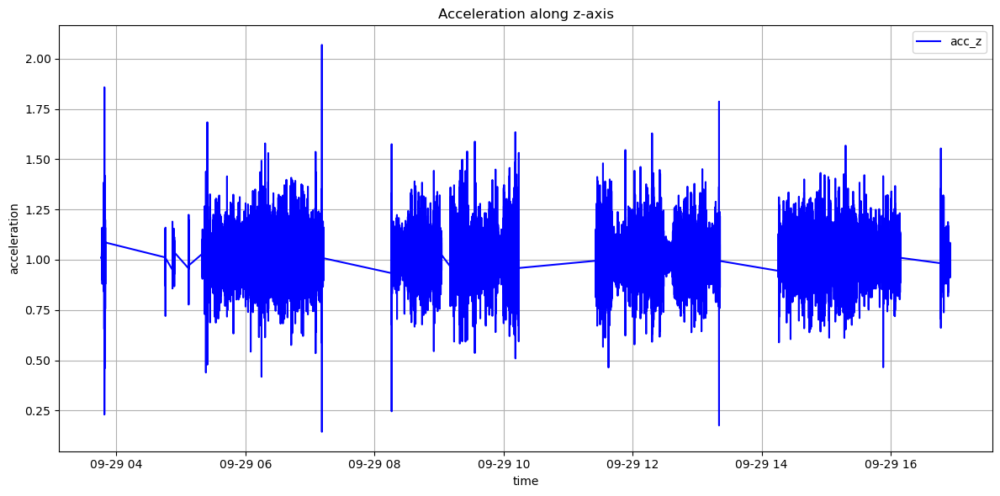

In [81]:
plot_acceleration_over_time(filtered_df, 'time', 'acc_z', 'Acceleration along z-axis', 'time', 'acceleration')

#### Data Segmentation

In [19]:
# Ensure that the data is sorted by timestamp (if it's not already sorted)
df_for_segment = filtered_df.sort_values(by='time')

# Define the time interval for segmentation (e.g., 10 seconds)
segment_interval = pd.Timedelta(seconds=300)

# Group the data into segments based on the defined interval
segmented_data = []
current_segment = []
prev_timestamp = df_for_segment['time'].iloc[0]

for index, row in df_for_segment.iterrows():
    if row['time'] - prev_timestamp <= segment_interval:
        current_segment.append(row)
    else:
        segmented_data.append(pd.DataFrame(current_segment))
        current_segment = [row]
    prev_timestamp = row['time']

# Concatenate the segmented data into a single DataFrame
df_segmented = pd.concat(segmented_data)

# Now you have segmented data that can be used for clustering and analysis
print("Segmented Data:")
df_segmented.head()

Segmented Data:


,time,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,vehicle_make,vehicle_model,vehicle_type,road_type
0,2022-09-29 03:46:06.458,-0.030,-0.028,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,TGX,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE
1,2022-09-29 03:46:06.558,-0.032,-0.029,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,TGX,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE
2,2022-09-29 03:46:06.658,-0.029,-0.027,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,TGX,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE
3,2022-09-29 03:46:06.758,-0.028,-0.029,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,TGX,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE
4,2022-09-29 03:46:06.858,-0.030,-0.029,1.015,0.0,43.238934,-2.877811,318.0,40,MAN,TGX,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE


In [7]:
df_segmented.shape

(260314, 13)

#### Feature Engineering

In [20]:
# Calculate acceleration magnitude
df_segmented['acc_magnitude'] = np.sqrt(df_segmented['acc_x']**2 + df_segmented['acc_y']**2 + df_segmented['acc_z']**2)

# Convert 'time' column to numeric (seconds since some reference time)
df_segmented['time_numeric'] = (df_segmented['time'] - df_segmented['time'].min()).dt.total_seconds()

# Calculate jerk (rate of change of acceleration magnitude)
df_segmented['jerk'] = np.gradient(df_segmented['acc_magnitude'], df_segmented['time_numeric'], edge_order=2)

# Calculate speed change (rate of change of speed)
df_segmented['speed_change'] = np.gradient(df_segmented['speed'], df_segmented['time_numeric'], edge_order=2)

# Calculate change in direction (angle between heading vector and acceleration vector)
# Assuming 'heading' is a column representing the heading direction in degrees
df_segmented['change_in_direction'] = np.arccos(
    (df_segmented['acc_x'] * np.cos(np.radians(df_segmented['heading'])) +
     df_segmented['acc_y'] * np.sin(np.radians(df_segmented['heading']))) / df_segmented['acc_magnitude']
)

# Calculate rolling statistics (rolling mean and rolling standard deviation)
window_size = 10  # Adjust the window size as needed
df_segmented['rolling_mean_acceleration'] = df_segmented['acc_magnitude'].rolling(window=window_size).mean()
df_segmented['rolling_std_acceleration'] = df_segmented['acc_magnitude'].rolling(window=window_size).std()

By creating meaningful features, you can capture characteristics or patterns that are indicative of such events. Here are some feature engineering ideas to help you identify sharp deceleration:

1. **Acceleration Magnitude**: Calculate the magnitude of the 3D acceleration vector (combining x, y, and z components) at each time step. A sudden increase in acceleration magnitude may indicate sharp deceleration.

2. **Jerk Calculation**: Jerk is the rate of change of acceleration. You can calculate jerk by taking the derivative of acceleration with respect to time. A sudden increase in jerk can signal abrupt changes in motion, like sharp deceleration.

3. **Speed Change**: Compute the rate of change of vehicle speed. A sharp deceleration event will likely correspond to a rapid decrease in speed over a short time interval.

4. **Change in Direction**: Analyze the change in direction (e.g., the angle between the vehicle's heading and acceleration vectors). Sudden changes in direction might indicate sharp maneuvers.

5. **Rolling Statistics**: Calculate rolling statistics (e.g., rolling mean or rolling standard deviation) of acceleration or speed over a fixed window. Abrupt changes in these statistics can be used to detect sharp deceleration.

In [11]:
df_segmented.head()

,time,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,vehicle_make,...,vehicle_type,road_type,road_type_encoded,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration
0,2022-09-29 03:46:06.458,-0.030,-0.028,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009834,0.0,-0.012911,0.0,1.574320,NaN,NaN
1,2022-09-29 03:46:06.558,-0.032,-0.029,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008925,0.1,-0.005278,0.0,1.575133,NaN,NaN
2,2022-09-29 03:46:06.658,-0.029,-0.027,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008778,0.2,0.004401,0.0,1.574251,NaN,NaN
3,2022-09-29 03:46:06.758,-0.028,-0.029,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009805,0.3,0.035394,0.0,1.572186,NaN,NaN
4,2022-09-29 03:46:06.858,-0.030,-0.029,1.015,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.015857,0.4,0.015425,0.0,1.573641,NaN,NaN


In [21]:
from sklearn.preprocessing import LabelEncoder

# Create a label encoder object
label_encoder = LabelEncoder()

# Apply label encoding to the 'road_type' column
df_segmented['road_type_encoded'] = label_encoder.fit_transform(df_segmented['road_type'])

In [12]:
df_segmented.head()

,time,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,vehicle_make,...,vehicle_type,road_type,road_type_encoded,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration
0,2022-09-29 03:46:06.458,-0.030,-0.028,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009834,0.0,-0.012911,0.0,1.574320,NaN,NaN
1,2022-09-29 03:46:06.558,-0.032,-0.029,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008925,0.1,-0.005278,0.0,1.575133,NaN,NaN
2,2022-09-29 03:46:06.658,-0.029,-0.027,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008778,0.2,0.004401,0.0,1.574251,NaN,NaN
3,2022-09-29 03:46:06.758,-0.028,-0.029,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009805,0.3,0.035394,0.0,1.572186,NaN,NaN
4,2022-09-29 03:46:06.858,-0.030,-0.029,1.015,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.015857,0.4,0.015425,0.0,1.573641,NaN,NaN


In [22]:
# Forward fill missing values
df_segmented['rolling_mean_acceleration'].fillna(method='bfill', inplace=True)
df_segmented['rolling_std_acceleration'].fillna(method='bfill', inplace=True)

In [23]:
df_segmented.isnull().sum()

time                         0
acc_x                        0
acc_y                        0
acc_z                        0
speed                        0
latitude                     0
longitude                    0
heading                      0
road_speed_limit             0
vehicle_make                 0
vehicle_model                0
vehicle_type                 0
road_type                    0
acc_magnitude                0
time_numeric                 0
jerk                         0
speed_change                 0
change_in_direction          0
rolling_mean_acceleration    0
rolling_std_acceleration     0
road_type_encoded            0
dtype: int64

In [24]:
# To print the mapping of encoded labels back to original values
encoded_labels = df_segmented['road_type_encoded']
original_labels = label_encoder.inverse_transform(encoded_labels)

# Print the mapping
label_mapping = dict(zip(encoded_labels, original_labels))
print(label_mapping)

{2: 'LOCAL_ROAD_OF_MAJOR_IMPORTANCE', 0: 'CONNECTING_ROAD', 3: 'MAJOR_ROAD', 6: 'SECONDARY_ROAD', 5: 'MOTORWAY', 1: 'DESTINATION_ROAD', 4: 'MAJOR_ROAD_OF_HIGH_IMPORTANCE'}


In [25]:
# Identify columns with data type 'object' (string or categorical)
object_columns = df_segmented.select_dtypes(include=['object']).columns

# Drop the identified columns from the DataFrame
df_numeric = df_segmented.drop(columns=object_columns)

In [40]:
df_segmented.head()

,time,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,vehicle_make,...,vehicle_type,road_type,road_type_encoded,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration
0,2022-09-29 03:46:06.458,-0.030,-0.028,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009834,0.0,-0.012911,0.0,1.574320,1.010738,0.003089
1,2022-09-29 03:46:06.558,-0.032,-0.029,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008925,0.1,-0.005278,0.0,1.575133,1.010738,0.003089
2,2022-09-29 03:46:06.658,-0.029,-0.027,1.008,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.008778,0.2,0.004401,0.0,1.574251,1.010738,0.003089
3,2022-09-29 03:46:06.758,-0.028,-0.029,1.009,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.009805,0.3,0.035394,0.0,1.572186,1.010738,0.003089
4,2022-09-29 03:46:06.858,-0.030,-0.029,1.015,0.0,43.238934,-2.877811,318.0,40,MAN,...,truck,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,2,1.015857,0.4,0.015425,0.0,1.573641,1.010738,0.003089


In [26]:
from sklearn.preprocessing import StandardScaler

# Select the columns you want to normalize (exclude 'datetime')
columns_to_normalize = ['acc_x', 'acc_y', 'acc_z', 'speed', 'latitude', 'longitude', 'heading',
                         'road_speed_limit', 'acc_magnitude', 'time_numeric', 'jerk',
                         'speed_change', 'change_in_direction', 'rolling_mean_acceleration',
                         'rolling_std_acceleration', 'road_type_encoded']

# Create a StandardScaler object
scaler = StandardScaler()

# Fit the scaler to the selected columns and transform the data
df_numeric[columns_to_normalize] = scaler.fit_transform(df_numeric[columns_to_normalize])

#### Modeling

In [27]:
X = df_numeric.copy()

In [76]:
df_numeric.isnull().sum()

time                         0
acc_x                        0
acc_y                        0
acc_z                        0
speed                        0
latitude                     0
longitude                    0
heading                      0
road_speed_limit             0
acc_magnitude                0
time_numeric                 0
jerk                         0
speed_change                 0
change_in_direction          0
rolling_mean_acceleration    0
rolling_std_acceleration     0
road_type_encoded            0
dtype: int64

In [82]:
!pip install --upgrade scikit-learn threadpoolctl

  Using cached threadpoolctl-3.2.0-py3-none-any.whl (15 kB)
  Attempting uninstall: threadpoolctl
    Found existing installation: threadpoolctl 2.2.0
    Uninstalling threadpoolctl-2.2.0:
      Successfully uninstalled threadpoolctl-2.2.0


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pycaret 3.0.2 requires numpy<1.24,>=1.21, but you have numpy 1.25.2 which is incompatible.


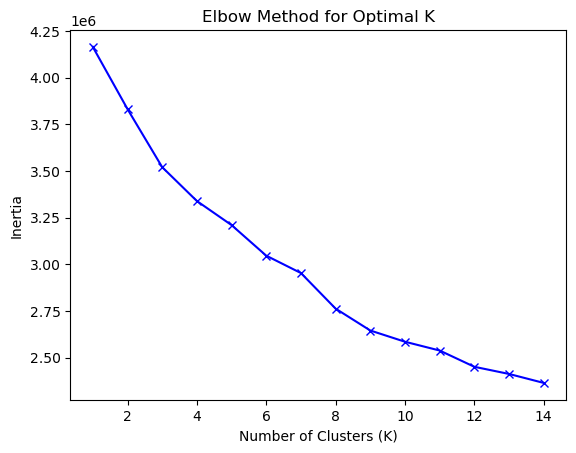

In [28]:
from sklearn.cluster import KMeans

X_numeric = X.drop(columns=['time'])

from sklearn.metrics import silhouette_score

K_range = range(1, 15)
inertia = []

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=0, n_init = 'auto')
    kmeans.fit(X_numeric)  # Replace X with your data
    inertia.append(kmeans.inertia_)

plt.plot(K_range, inertia, 'bx-')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal K')
plt.show()

In [29]:
kmeans = KMeans(n_clusters=8, random_state=0, n_init = 'auto')  # Replace optimal_k with the chosen number of clusters
kmeans.fit(X_numeric)  # Fit the model to your data

KMeans(n_init='auto', random_state=0)

In [30]:
cluster_labels = kmeans.labels_

In [31]:
df_segmented['cluster_labels'] = kmeans.labels_

In [27]:
X_numeric.head()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
0,-0.646948,-0.648728,-0.054725,-4.585099,1.530672,1.3285,1.380547,-2.807539,-0.066239,-2.028108,-0.008346,0.003479,0.016958,-0.223702,-1.465492,-4.123457,4
1,-0.700032,-0.673690,-0.071855,-4.585099,1.530672,1.3285,1.380547,-2.807539,-0.081809,-2.028100,-0.003771,0.003479,0.038216,-0.223702,-1.465492,-4.123457,4
2,-0.620405,-0.623766,-0.071855,-4.585099,1.530672,1.3285,1.380547,-2.807539,-0.084313,-2.028092,0.002032,0.003479,0.015136,-0.223702,-1.465492,-4.123457,4
3,-0.593863,-0.673690,-0.054725,-4.585099,1.530672,1.3285,1.380547,-2.807539,-0.066739,-2.028084,0.020612,0.003479,-0.038844,-0.223702,-1.465492,-4.123457,4
4,-0.646948,-0.673690,0.048055,-4.585099,1.530672,1.3285,1.380547,-2.807539,0.036878,-2.028076,0.008641,0.003479,-0.000809,-0.223702,-1.465492,-4.123457,4


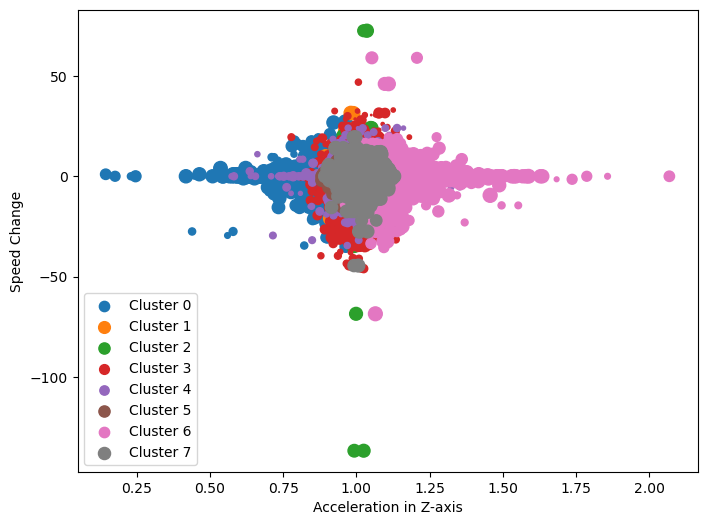

In [44]:
# Assuming 'X' is your original dataset with columns 'feature1' and 'feature2'
X = df_segmented[['acc_z', 'speed_change']].values

# Assuming 'cluster_labels' contains the cluster labels assigned by your clustering model
cluster_labels = kmeans.labels_  # Replace with the actual cluster labels

bubble_size = df_segmented['speed'].values

# Create a scatter plot with different colors for each cluster
plt.figure(figsize=(8, 6))

for cluster_label in set(cluster_labels):
    plt.scatter(
        X[cluster_labels == cluster_label, 0],
        X[cluster_labels == cluster_label, 1],
        label=f'Cluster {cluster_label}',
        s=bubble_size[cluster_labels == cluster_label]
    )

# # Plot the centroids
# plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=200, c='red', label='Centroids')

plt.xlabel('Acceleration in Z-axis')
plt.ylabel('Speed Change')

plt.legend()
plt.show()

In [20]:
cluster_labels

array([4, 4, 4, ..., 4, 4, 4])

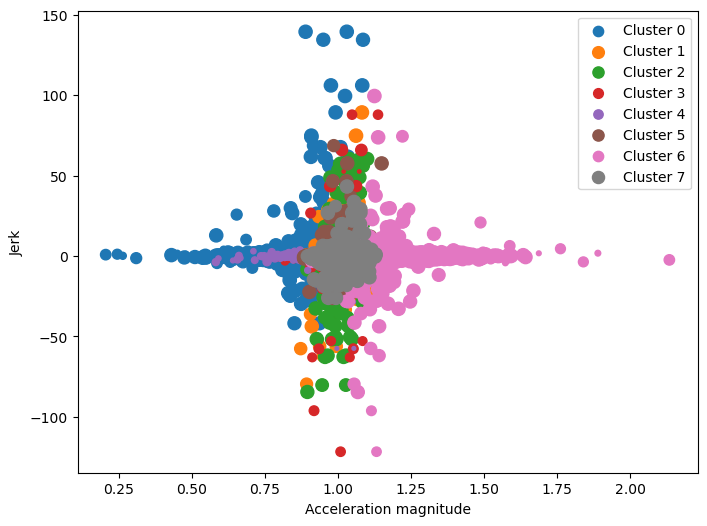

In [48]:
# Assuming 'X' is your original dataset with columns 'feature1' and 'feature2'
X = df_segmented[['acc_magnitude', 'jerk']].values

# Assuming 'cluster_labels' contains the cluster labels assigned by your clustering model
cluster_labels = kmeans.labels_  # Replace with the actual cluster labels

bubble_size = df_segmented['speed'].values

# Create a scatter plot with different colors for each cluster
plt.figure(figsize=(8, 6))

for cluster_label in set(cluster_labels):
    plt.scatter(
        X[cluster_labels == cluster_label, 0],
        X[cluster_labels == cluster_label, 1],
        label=f'Cluster {cluster_label}',
        s=bubble_size[cluster_labels == cluster_label]
    )

# # Plot the centroids
# plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=200, c='red', label='Centroids')

plt.xlabel('Acceleration magnitude')
plt.ylabel('Jerk')

plt.legend()
plt.show()

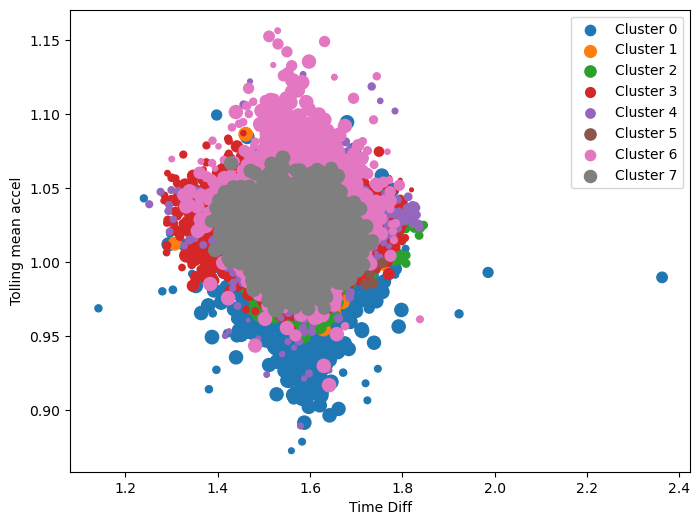

In [51]:
# Assuming 'X' is your original dataset with columns 'feature1' and 'feature2'
X = df_segmented[['change_in_direction', 'rolling_mean_acceleration']].values

# Assuming 'cluster_labels' contains the cluster labels assigned by your clustering model
cluster_labels = kmeans.labels_  # Replace with the actual cluster labels

bubble_size = df_segmented['speed'].values

# Create a scatter plot with different colors for each cluster
plt.figure(figsize=(8, 6))

for cluster_label in set(cluster_labels):
    plt.scatter(
        X[cluster_labels == cluster_label, 0],
        X[cluster_labels == cluster_label, 1],
        label=f'Cluster {cluster_label}',
        s=bubble_size[cluster_labels == cluster_label]
    )

# # Plot the centroids
# plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=200, c='red', label='Centroids')

plt.xlabel('Time Diff')
plt.ylabel('Tolling mean accel')

plt.legend()
plt.show()

#### Cluster Analysis

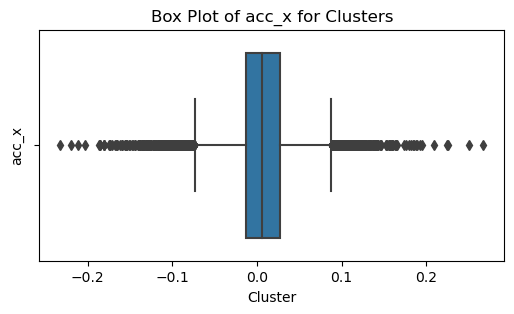

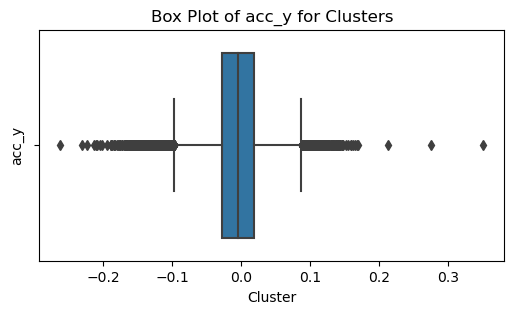

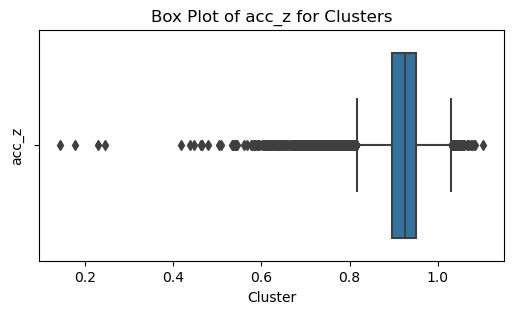

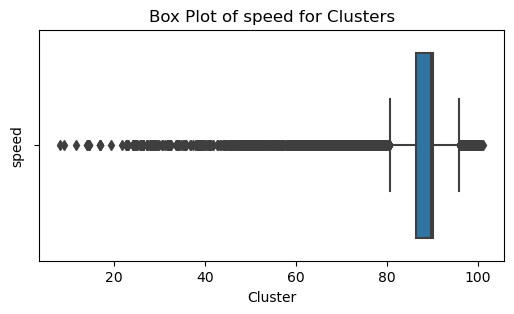

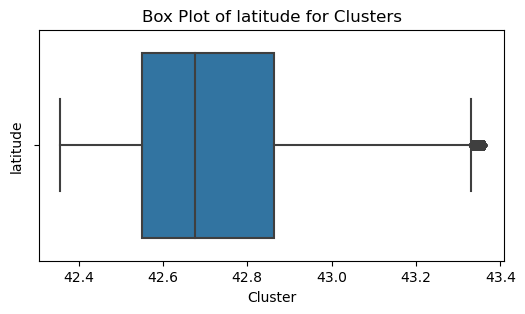

...

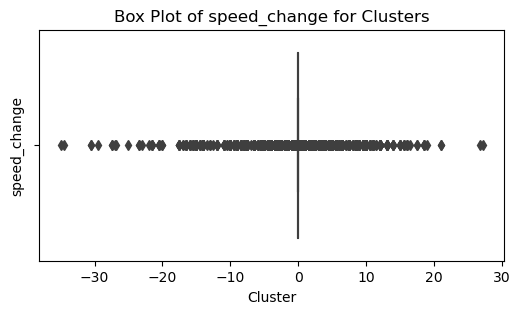

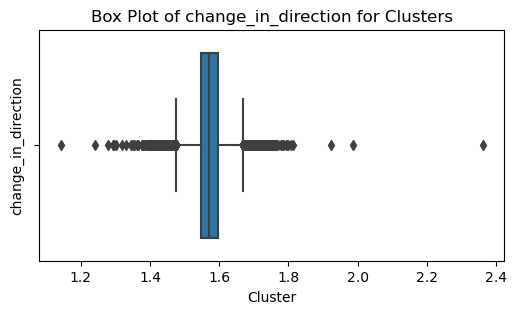

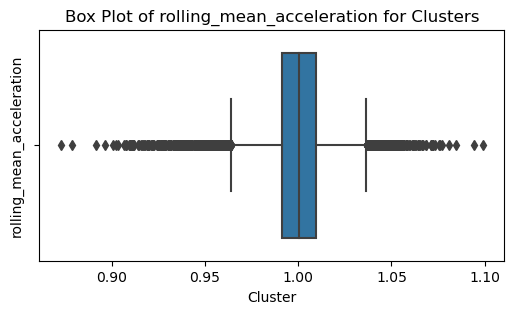

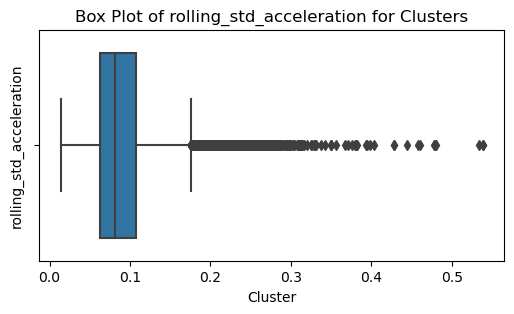

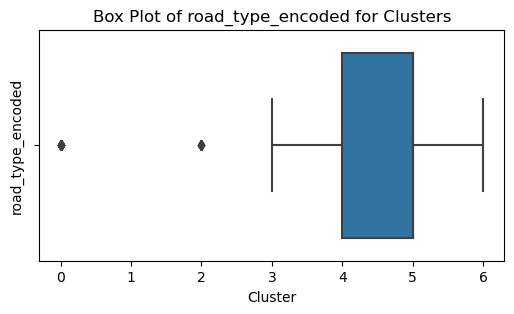

In [66]:
data = df_segmented[df_segmented['cluster_labels'] == 0]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

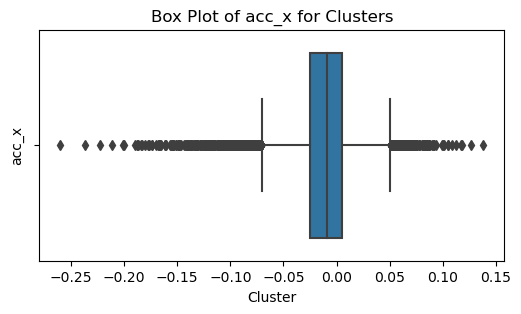

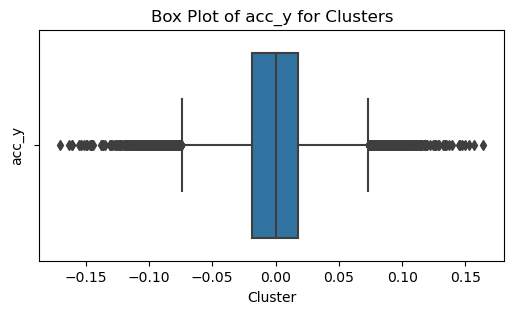

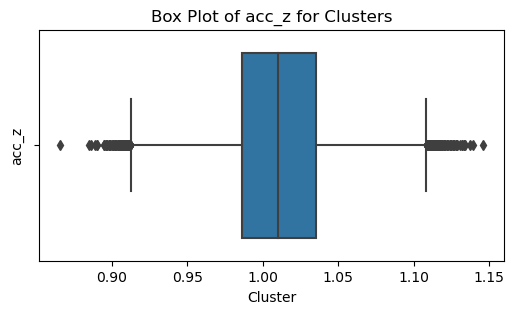

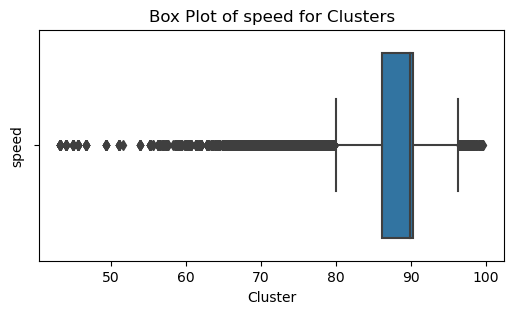

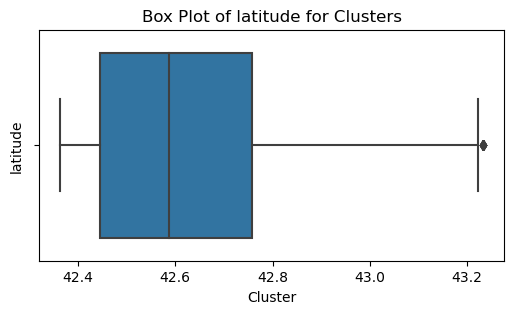

...

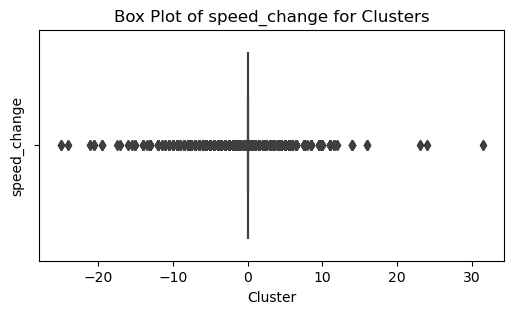

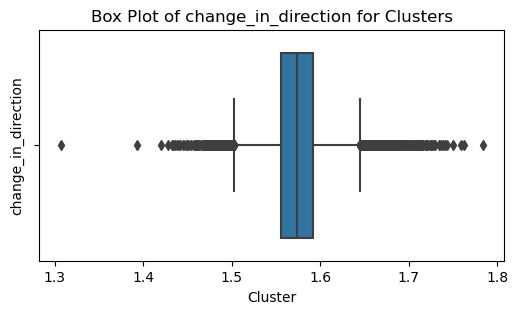

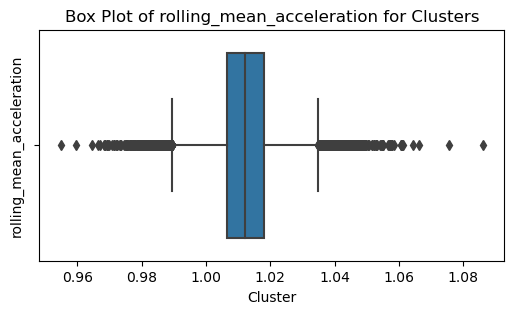

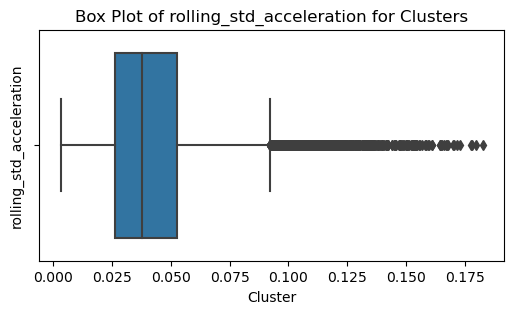

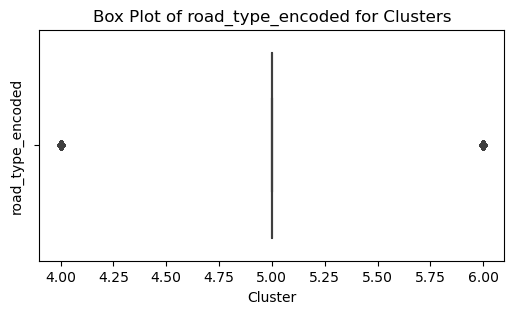

In [65]:
data = df_segmented[df_segmented['cluster_labels'] == 1]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

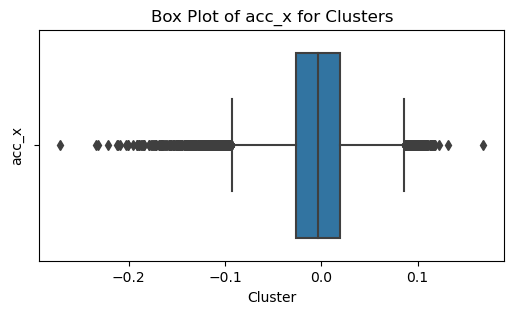

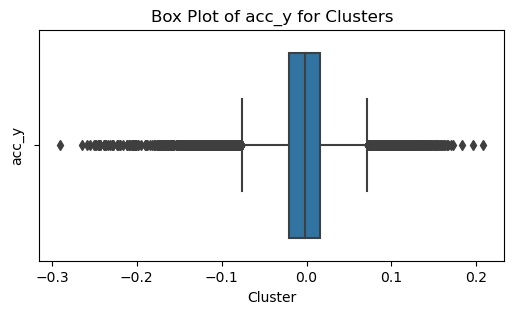

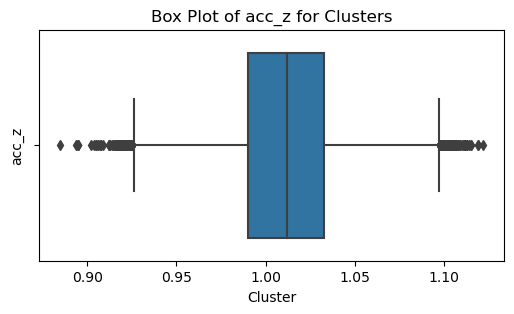

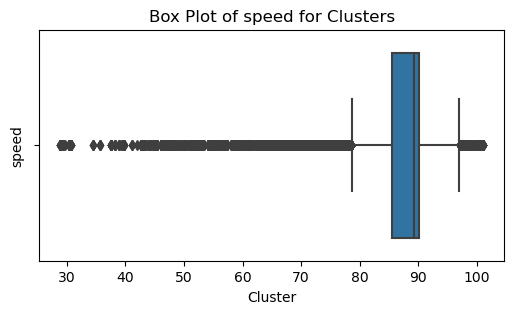

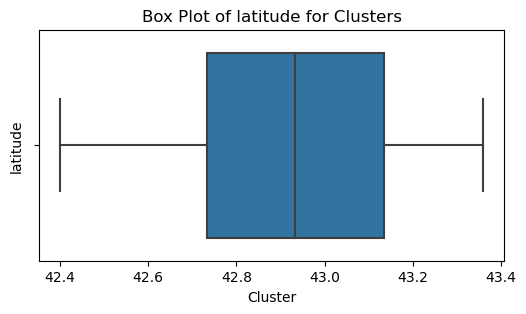

...

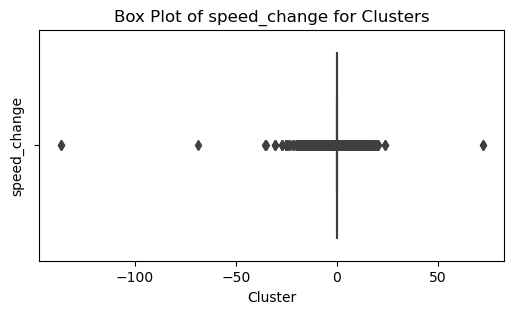

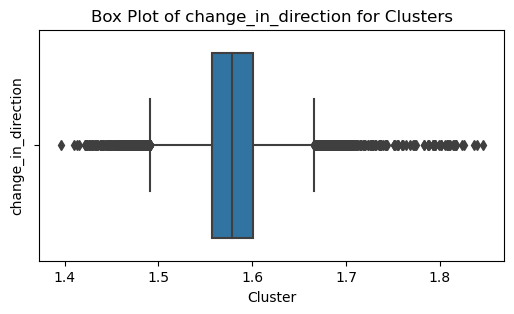

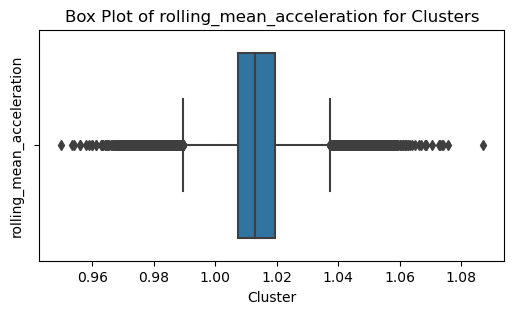

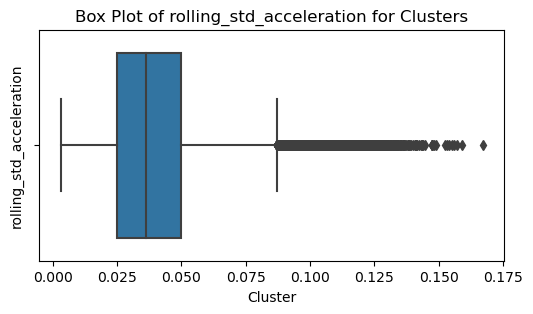

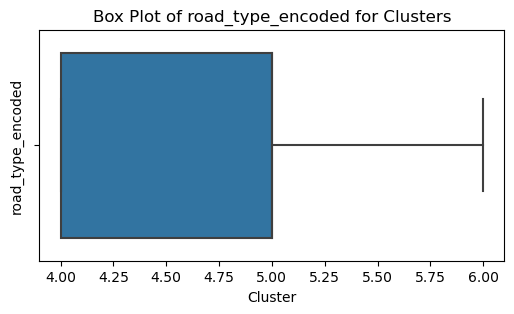

In [64]:
data = df_segmented[df_segmented['cluster_labels'] == 2]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

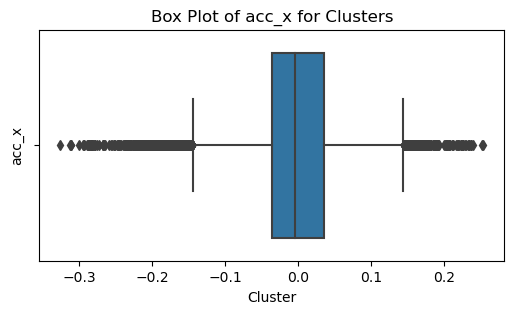

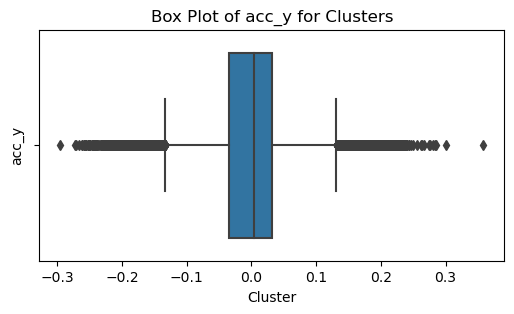

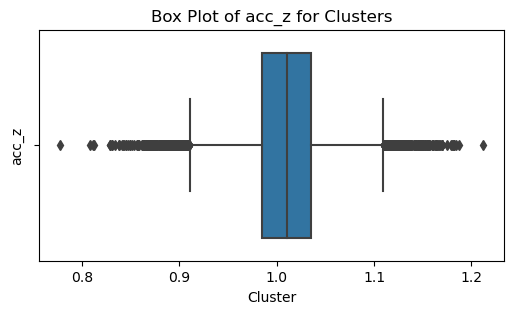

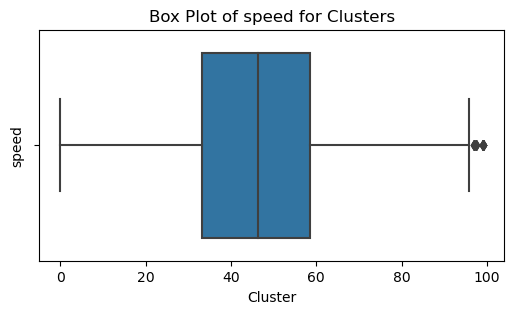

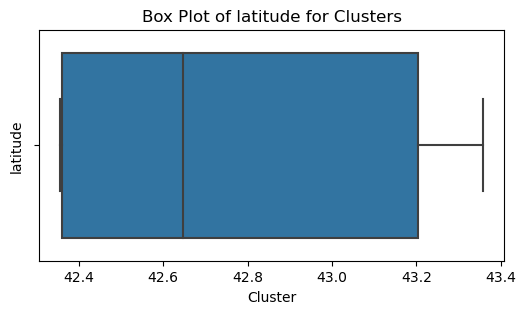

...

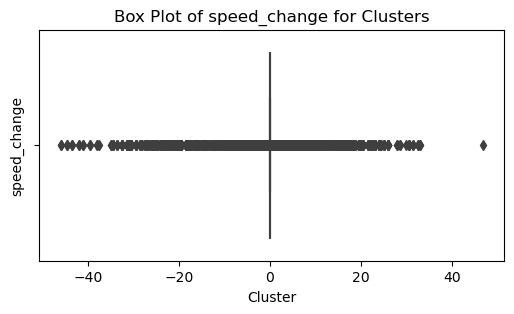

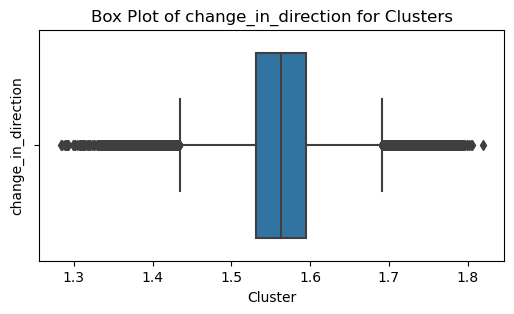

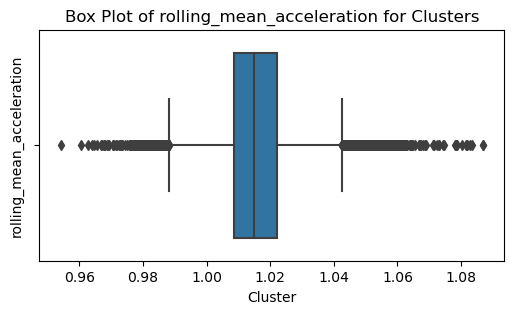

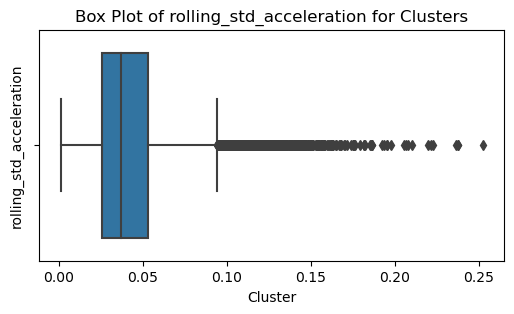

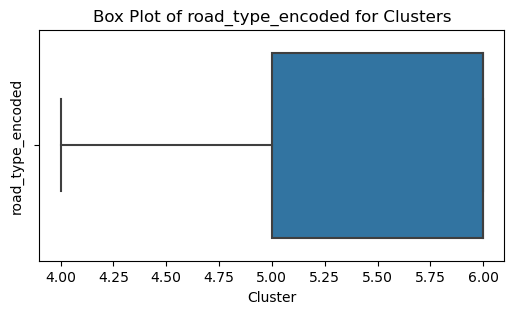

In [63]:
data = df_segmented[df_segmented['cluster_labels'] == 3]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

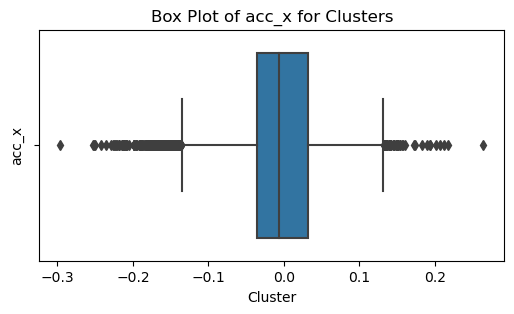

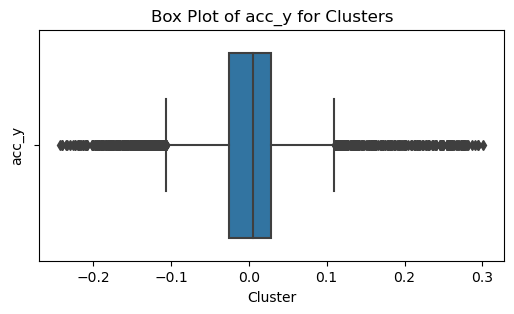

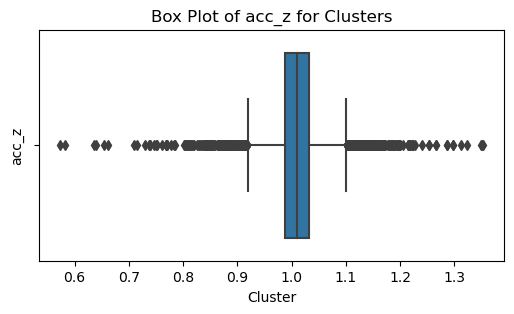

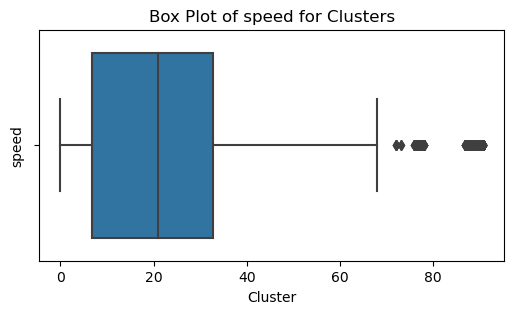

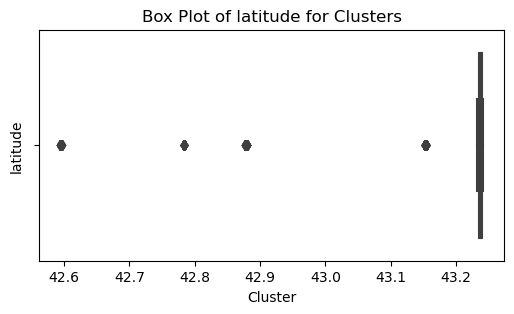

...

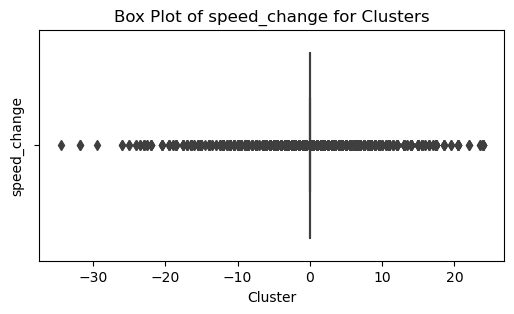

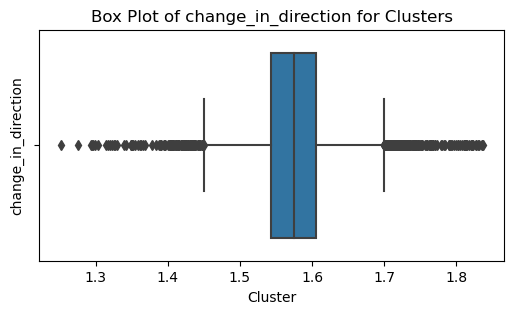

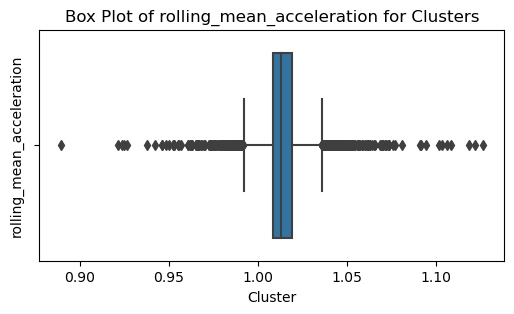

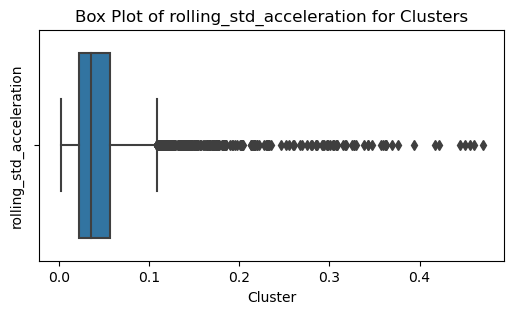

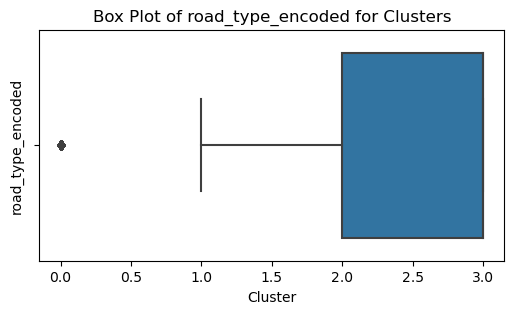

In [62]:
data = df_segmented[df_segmented['cluster_labels'] == 4]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

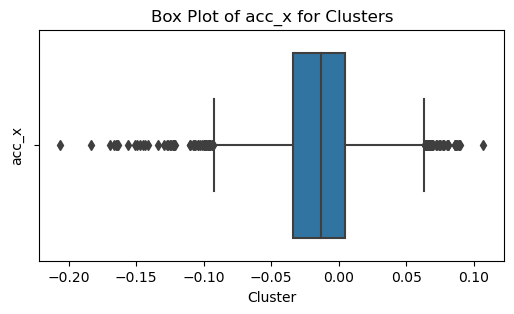

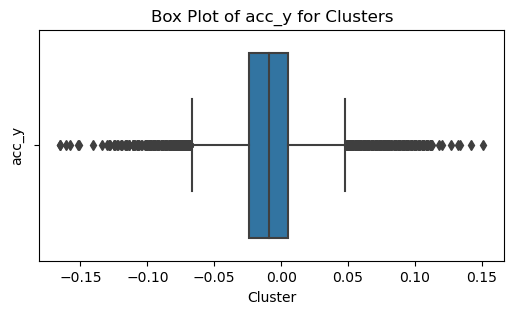

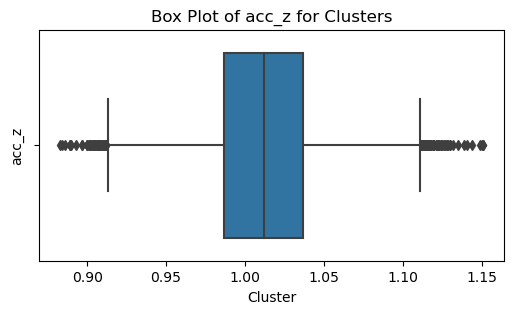

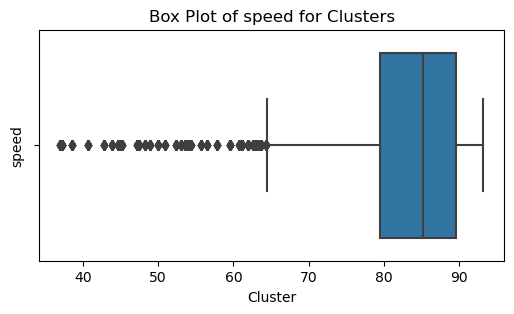

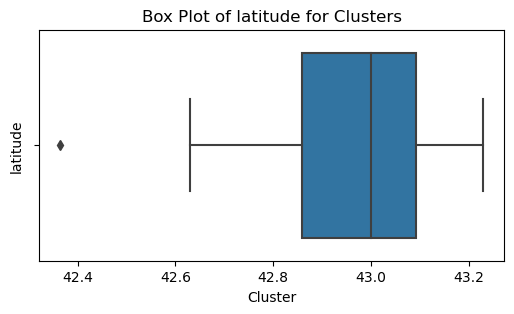

...

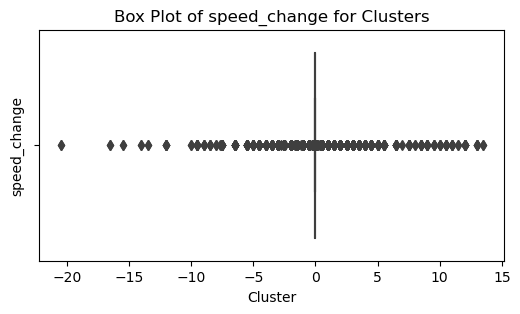

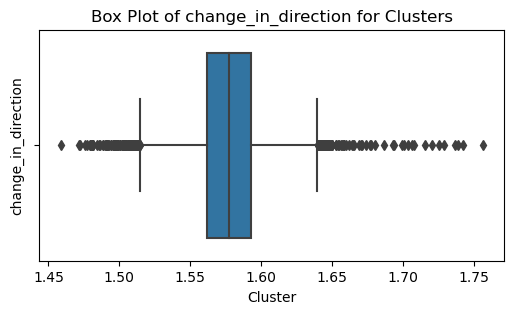

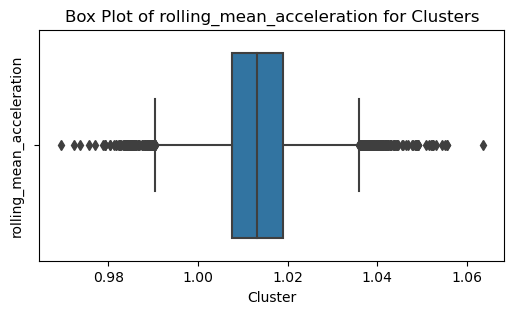

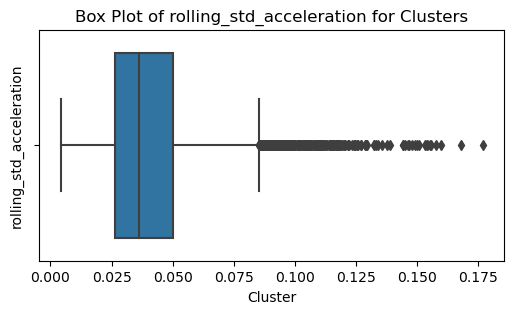

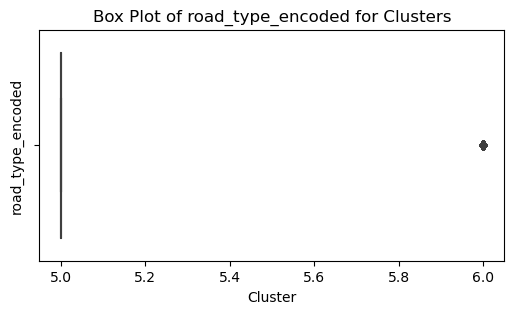

In [61]:
data = df_segmented[df_segmented['cluster_labels'] == 5]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

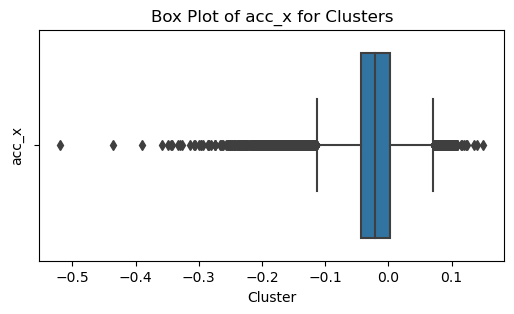

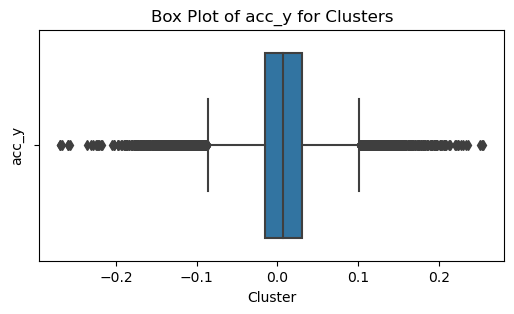

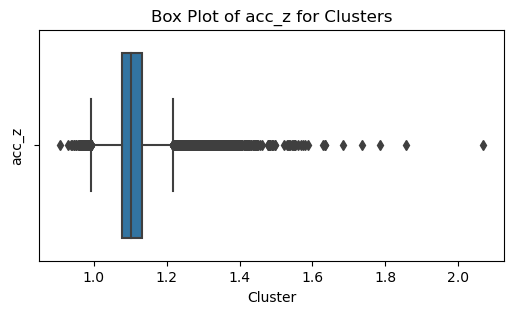

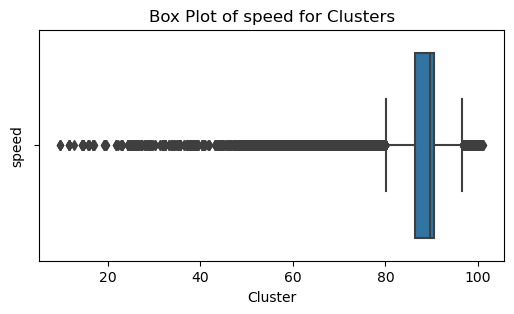

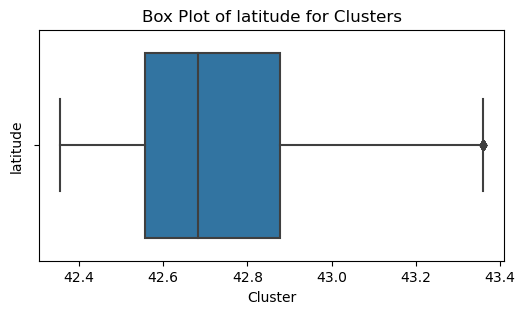

...

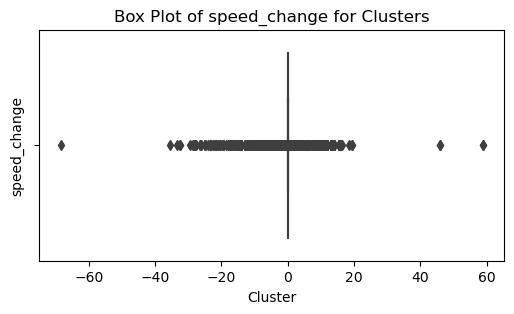

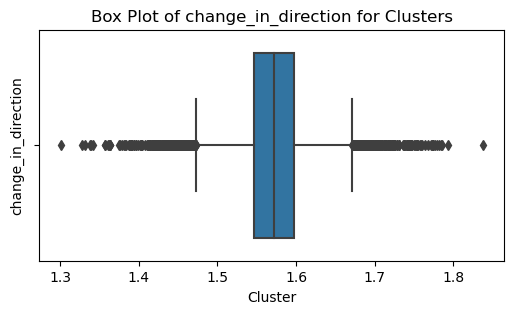

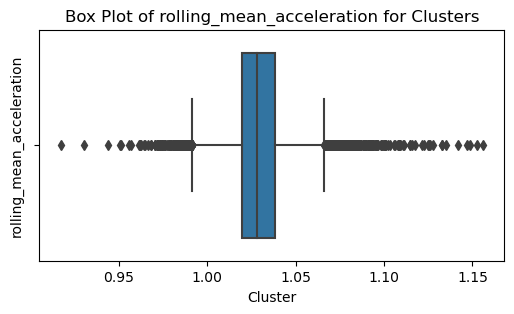

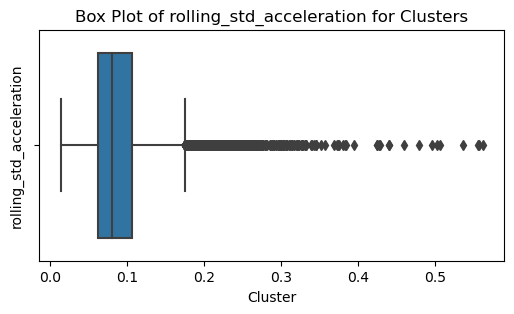

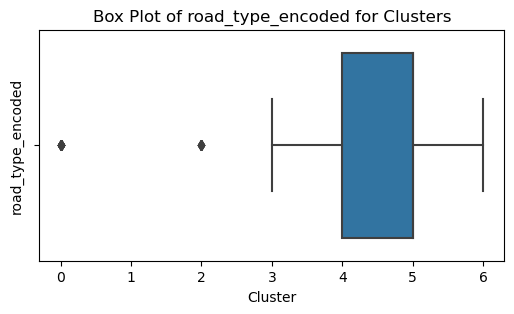

In [60]:
data = df_segmented[df_segmented['cluster_labels'] == 6]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

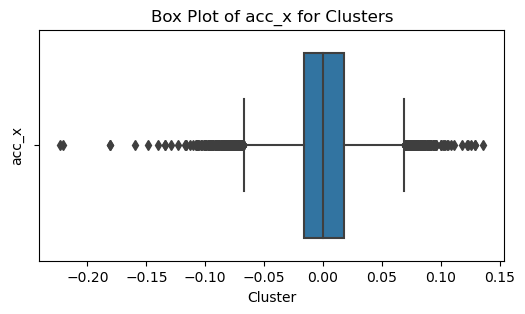

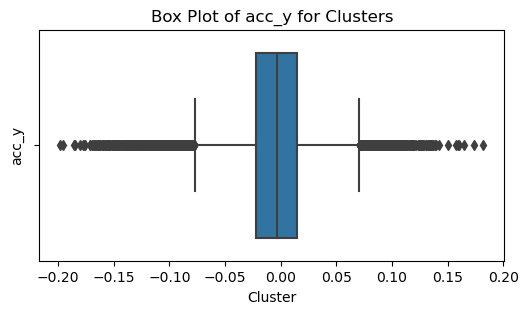

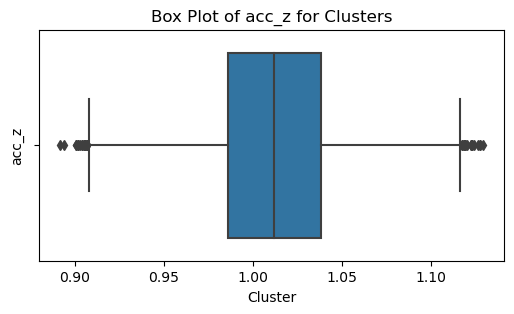

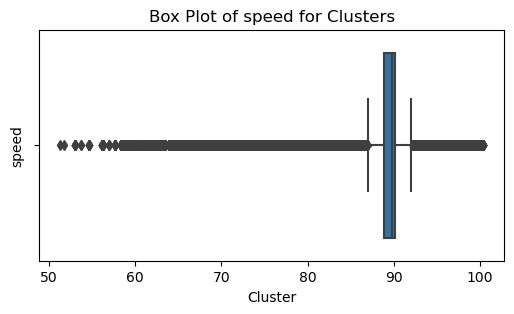

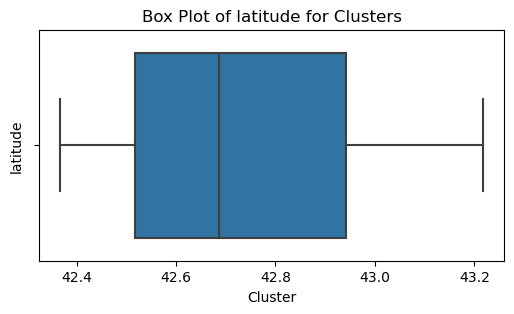

...

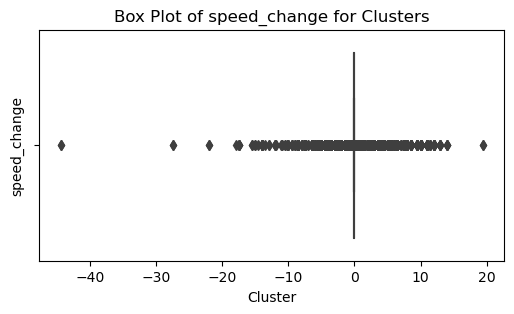

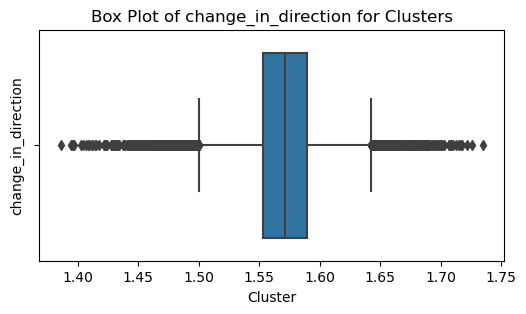

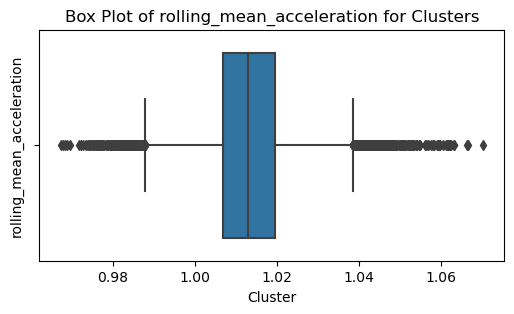

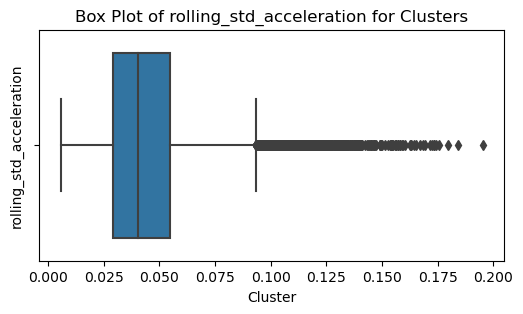

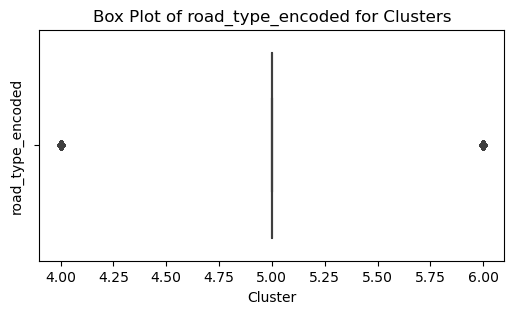

In [59]:
data = df_segmented[df_segmented['cluster_labels'] == 7]
# Extract numeric features (excluding 'cluster_labels')
numeric_features = data.drop(columns=['cluster_labels'])
# Get a list of numeric column names
numeric_columns = numeric_features.select_dtypes(include=['number']).columns
# Create box plots for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(6, 3))
    sns.boxplot(x=column, data=numeric_features)
    plt.title(f'Box Plot of {column} for Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

In [87]:
data_6 = df_segmented[df_segmented['cluster_labels'] == 6]
data_6.describe(percentiles = [0.25,0.5,0.75,0.9, 0.95, 0.99])

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,24270.00000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,24270.000000,2.427000e+04,24270.000000,24270.000000,24270.000000,24270.000000,24270.0
mean,-0.02341,0.006826,1.110860,86.217433,42.751923,-3.698784,184.092727,104.218377,1.112834,24438.951502,-0.128491,-8.334259e-02,1.572110,1.029267,0.089730,4.636424,6.0
std,0.04248,0.045012,0.057678,9.915961,0.263835,0.425704,100.793359,17.361405,0.057994,10327.238797,2.182092,2.063938e+00,0.040636,0.015971,0.041472,0.550690,0.0
min,-0.51900,-0.269000,0.908000,9.800000,42.356335,-4.242470,0.008880,30.000000,0.911906,127.363000,-121.667103,-6.850000e+01,1.300303,0.916875,0.013734,0.000000,6.0
25%,-0.04400,-0.016000,1.077000,86.300000,42.555864,-4.064742,107.300557,90.000000,1.078333,17534.124000,-0.482588,0.000000e+00,1.547036,1.019416,0.062047,4.000000,6.0
50%,-0.02100,0.007000,1.102000,89.600000,42.681777,-3.785242,190.295570,100.000000,1.104164,22785.369000,-0.111470,0.000000e+00,1.571996,1.028264,0.080804,5.000000,6.0
75%,0.00200,0.031000,1.133000,90.400000,42.877150,-3.372832,266.698733,120.000000,1.134590,32688.911000,0.281747,0.000000e+00,1.596864,1.038114,0.107139,5.000000,6.0
90%,0.02300,0.058000,1.175000,91.700000,43.203637,-2.923115,321.894762,120.000000,1.177440,39487.373000,0.692487,5.684342e-14,1.620365,1.048786,0.141108,5.000000,6.0
95%,0.03700,0.077000,1.212000,93.700000,43.324877,-2.900510,338.376325,120.000000,1.214152,40680.372000,0.987229,1.000000e+00,1.636008,1.056169,0.167768,5.000000,6.0
99%,0.06600,0.126000,1.316310,98.000000,43.357170,-2.877352,354.252978,120.000000,1.320319,43325.482690,1.868796,5.000000e+00,1.674119,1.074268,0.228141,6.000000,6.0


In [88]:
data_6 = data_6[data_6['road_speed_limit']<40]

In [89]:
data_6.describe()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.0,6.000000,6.000000,6.000000,6.000000e+00,6.000000,6.000000,6.000000,6.0,6.0
mean,-0.111000,0.021667,1.372000,26.033333,43.237217,-2.875568,316.055443,30.0,1.383352,5823.047667,-0.614623,0.000000e+00,1.640149,1.057092,0.248436,2.0,6.0
std,0.145901,0.023132,0.072435,5.557218,0.000031,0.000043,0.141725,0.0,0.069883,0.719491,1.793327,8.987734e-15,0.081327,0.025453,0.088982,0.0,0.0
min,-0.306000,-0.002000,1.266000,19.600000,43.237183,-2.875618,315.954860,30.0,1.291692,5822.231000,-2.655312,-1.421085e-14,1.555451,1.022473,0.132727,2.0,6.0
25%,-0.223500,0.007000,1.322500,21.325000,43.237193,-2.875603,315.962425,30.0,1.325168,5822.481000,-2.034407,0.000000e+00,1.568143,1.046402,0.178680,2.0,6.0
50%,-0.089000,0.013000,1.403000,26.500000,43.237215,-2.875567,315.969850,30.0,1.418753,5822.981000,-0.595994,0.000000e+00,1.632429,1.052123,0.267409,2.0,6.0
75%,0.010250,0.038500,1.419750,30.625000,43.237242,-2.875534,316.170175,30.0,1.432682,5823.631000,1.000804,0.000000e+00,1.710277,1.069549,0.315554,2.0,6.0
max,0.043000,0.054000,1.439000,32.000000,43.237255,-2.875517,316.241200,30.0,1.439615,5823.931000,1.140370,1.421085e-14,1.737642,1.095982,0.342365,2.0,6.0


In [90]:
data_5 = df_segmented[df_segmented['cluster_labels'] == 5]
data_5.describe(percentiles = [0.25,0.5,0.75,0.9, 0.95, 0.99])

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,13230.000000,1.323000e+04,13230.000000,13230.000000,13230.000000,13230.000000,13230.0
mean,-0.013967,-0.009008,1.012251,83.174324,42.974074,-2.905093,335.462449,115.480726,1.013138,42712.742416,0.020129,-1.555177e-02,1.577272,1.013255,0.040167,5.049887,5.0
std,0.028692,0.026478,0.038750,8.385113,0.145712,0.022601,16.761953,13.288101,0.038818,807.849833,1.551091,1.353416e+00,0.025006,0.008964,0.019162,0.217719,0.0
min,-0.206000,-0.165000,0.883000,37.000000,42.364975,-3.639635,292.662800,50.000000,0.883191,37995.084000,-26.098573,-2.050000e+01,1.458512,0.969321,0.004133,5.000000,5.0
25%,-0.034000,-0.024000,0.987000,79.500000,42.858351,-2.917677,322.772840,120.000000,0.987549,42077.648000,-0.204576,0.000000e+00,1.561541,1.007505,0.026433,5.000000,5.0
50%,-0.013000,-0.009000,1.012000,85.200000,42.999514,-2.903806,338.088070,120.000000,1.012534,42833.437000,-0.001071,0.000000e+00,1.577358,1.013156,0.036349,5.000000,5.0
75%,0.005000,0.005000,1.037000,89.600000,43.091884,-2.893344,349.558390,120.000000,1.038317,43352.575000,0.204050,0.000000e+00,1.592873,1.018885,0.049930,5.000000,5.0
90%,0.021000,0.020000,1.062000,90.200000,43.143988,-2.876864,355.824950,120.000000,1.063263,43656.912000,0.419859,5.684342e-14,1.608569,1.024201,0.064925,5.000000,5.0
95%,0.031000,0.031000,1.078000,90.400000,43.194807,-2.873682,357.990591,120.000000,1.078608,43973.496000,0.574149,1.000000e+00,1.617721,1.027827,0.076031,5.000000,5.0
99%,0.054000,0.073710,1.106000,91.700000,43.226172,-2.869332,359.633130,120.000000,1.107482,44228.132000,0.986662,4.500000e+00,1.634110,1.036080,0.103645,6.000000,5.0


In [91]:
data_5 = data_5[data_5['road_speed_limit']<40]
data_5.describe()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [92]:
data_4 = df_segmented[df_segmented['cluster_labels'] == 4]
data_4 = data_4[data_4['road_speed_limit']<40]
data_4.describe()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.0,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.000000,1236.0
mean,-0.006833,0.006464,1.009441,17.431472,43.199289,-2.984130,270.502056,30.0,1.014038,6732.731855,0.006393,0.071651,1.586740,1.014486,0.037078,1.919094,4.0
std,0.058090,0.076473,0.043273,14.313332,0.123489,0.371645,69.708652,0.0,0.043291,3886.218965,0.399259,3.469054,0.064218,0.010264,0.034607,0.272801,0.0
min,-0.225000,-0.223000,0.730000,0.000000,42.783012,-4.236460,1.728704,30.0,0.736527,3989.602000,-3.526248,-34.500000,1.401611,0.965124,0.001884,1.000000,4.0
25%,-0.032000,-0.020000,0.990000,3.300000,43.234500,-2.875894,222.106285,30.0,0.995144,5684.478000,-0.148129,0.000000,1.546933,1.009528,0.018592,2.000000,4.0
50%,-0.002000,0.015000,1.010000,14.300000,43.235256,-2.873908,311.901290,30.0,1.013275,5805.181000,0.004776,0.000000,1.580307,1.013224,0.030851,2.000000,4.0
75%,0.028000,0.037000,1.029000,29.425000,43.237356,-2.872313,315.625968,30.0,1.033244,5838.818000,0.156929,0.000000,1.608074,1.018885,0.044487,2.000000,4.0
max,0.130000,0.290000,1.266000,42.600000,43.237988,-2.872027,359.358730,30.0,1.276002,19705.459000,3.462964,24.000000,1.835633,1.091498,0.342349,2.000000,4.0


In [93]:
data_3 = df_segmented[df_segmented['cluster_labels'] == 3]
data_3 = data_3[data_3['road_speed_limit']<40]
data_3.describe()

,acc_x,acc_y,acc_z,speed,latitude,longitude,heading,road_speed_limit,acc_magnitude,time_numeric,jerk,speed_change,change_in_direction,rolling_mean_acceleration,rolling_std_acceleration,road_type_encoded,cluster_labels
count,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.0,90.000000,90.00000,90.000000,90.000000,90.000000,90.000000,90.000000,90.0,90.0
mean,-0.045844,0.015022,1.009556,53.133333,42.360245,-3.643891,255.482464,30.0,1.012034,12227.06200,-0.003881,-1.594444,1.573667,1.011555,0.027816,6.0,3.0
std,0.050675,0.012484,0.027068,5.151415,0.000086,0.000445,0.294951,0.0,0.027248,2.61247,0.199634,3.806333,0.016872,0.006313,0.007390,0.0,0.0
min,-0.101000,-0.011000,0.932000,45.200000,42.360107,-3.644608,254.994860,30.0,0.933485,12222.61200,-0.508187,-12.500000,1.546283,0.997632,0.011531,6.0,3.0
25%,-0.083750,0.006000,0.992000,48.900000,42.360172,-3.644271,255.230510,30.0,0.994348,12224.83700,-0.132864,0.000000,1.560793,1.007034,0.021777,6.0,3.0
50%,-0.070500,0.015000,1.015000,53.300000,42.360238,-3.643916,255.444630,30.0,1.017075,12227.06200,-0.000988,0.000000,1.572702,1.012155,0.025972,6.0,3.0
75%,-0.002000,0.024250,1.027750,58.200000,42.360316,-3.643519,255.719920,30.0,1.029854,12229.28700,0.114132,0.000000,1.586144,1.015804,0.034530,6.0,3.0
max,0.060000,0.055000,1.073000,59.800000,42.360400,-3.643091,255.984100,30.0,1.073755,12231.51200,0.424183,4.500000,1.617797,1.029559,0.046781,6.0,3.0


In [191]:
numeric_columns = data_6.select_dtypes(include=['number']).columns
data = data_6[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [192]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk','acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
3161,316.2352,NaN,NaN,1.140370,NaN
3162,316.2412,NaN,NaN,NaN,NaN
3168,NaN,NaN,NaN,NaN,1.425
3169,NaN,NaN,NaN,NaN,NaN
3177,NaN,NaN,NaN,1.062941,1.439
3178,NaN,NaN,1.421085e-14,NaN,NaN


In [193]:
range_below_10th[['heading', 'road_speed_limit', 'speed_change', 'jerk', 'acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
3161,NaN,NaN,NaN,NaN,NaN
3162,NaN,NaN,NaN,-2.655312,1.266
3168,NaN,NaN,NaN,NaN,NaN
3169,315.95486,NaN,NaN,NaN,1.296
3177,NaN,NaN,-1.421085e-14,NaN,NaN
3178,315.96170,NaN,NaN,-2.043749,NaN


In [132]:
from sklearn.cluster import KMeans

numeric_columns = df_segmented.select_dtypes(include=['number']).columns
X = df_segmented[numeric_columns]  # Removed .columns
X.drop(columns = 'time_numeric', inplace = True)
# Fit a K-Means model to your data
kmeans = KMeans(n_clusters=8)
cluster_labels = kmeans.fit_predict(X)

# Calculate feature importances based on feature variance within clusters
feature_importances = X.var(axis=0)  # Calculate variance along each feature (column)

# Sort feature importances in descending order and get the corresponding feature names
sorted_indices = feature_importances.argsort()[::-1]
sorted_feature_importances = feature_importances[sorted_indices]
sorted_feature_names = X.columns[sorted_indices]

# Create a DataFrame to display feature importance
feature_importance_df = pd.DataFrame({
    'Feature': sorted_feature_names,
    'Variance (Importance)': sorted_feature_importances
})

# Reset the index
feature_importance_df = feature_importance_df.reset_index(drop=True)


C:\Users\Z004R5VB\AppData\Local\Temp\ipykernel_26272\224361609.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X.drop(columns = 'time_numeric', inplace = True)
C:\Users\Z004R5VB\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [133]:
feature_importance_df

,Feature,Variance (Importance)
0,heading,11159.783002
1,road_speed_limit,529.277182
2,speed,316.213876
3,cluster_labels,5.947456
4,speed_change,3.965995
5,jerk,2.782522
6,road_type_encoded,0.467633
7,longitude,0.244440
8,latitude,0.081640
9,acc_magnitude,0.003412


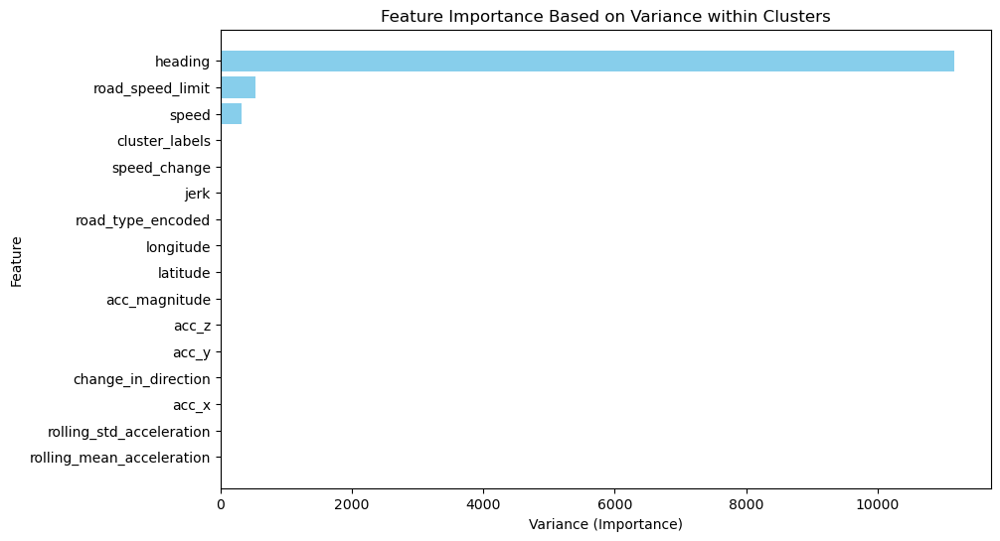

In [134]:
import matplotlib.pyplot as plt

# Sort feature importances in descending order for a meaningful bar chart
sorted_feature_importances = feature_importance_df['Variance (Importance)']
sorted_feature_names = feature_importance_df['Feature']

# Create a horizontal bar chart
plt.figure(figsize=(10, 6))
plt.barh(sorted_feature_names, sorted_feature_importances, color='skyblue')
plt.xlabel('Variance (Importance)')
plt.ylabel('Feature')
plt.title('Feature Importance Based on Variance within Clusters')
plt.gca().invert_yaxis()  # Invert the y-axis to display the most important feature at the top
plt.show()

#### Cluster based rules

In [143]:
import pandas as pd

def calculate_percentile_ranges(dataframe, lower_percentile=0.1, upper_percentile=0.9):
    """
    Calculate the range below the lower_percentile and beyond the upper_percentile
    for each numeric feature in the given DataFrame.

    Parameters:
        dataframe (pd.DataFrame): The input DataFrame containing numeric features.
        lower_percentile (float): The lower percentile (e.g., 0.1 for 10th percentile).
        upper_percentile (float): The upper percentile (e.g., 0.9 for 90th percentile).

    Returns:
        pd.DataFrame: A DataFrame containing the range below the lower_percentile
                     and beyond the upper_percentile for each feature.
    """
    # Select only numeric columns
    numeric_columns = dataframe.select_dtypes(include=['number'])
    data = dataframe.loc[:, numeric_columns]
    
    # Calculate the lower and upper percentiles
    lower_percentiles = data.quantile(lower_percentile)
    upper_percentiles = data.quantile(upper_percentile)

    # Calculate the range below the lower_percentile and beyond the upper_percentile
    range_below_lower = data[data < lower_percentiles]
    range_beyond_upper = data[data > upper_percentiles]

    # Combine the two ranges into a single DataFrame
    range_data = pd.concat([range_below_lower, range_beyond_upper], axis=1)

    return range_data


In [181]:
data_0 = df_segmented[df_segmented['cluster_labels'] == 0]
data_0 = data_0[data_0['road_speed_limit']<40]
numeric_columns = data_0.select_dtypes(include=['number']).columns
data = data_0[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [182]:
range_below_10th[['heading', 'road_speed_limit', 'speed_change', 'jerk', 'acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
3164,NaN,NaN,NaN,-2.315622,0.579
3165,NaN,NaN,-27.5,NaN,0.439
3171,315.96160,NaN,NaN,-1.160163,NaN
3172,315.96085,NaN,NaN,NaN,NaN
3173,NaN,NaN,NaN,NaN,NaN
3174,NaN,NaN,-34.5,NaN,NaN


In [184]:
range_below_10th.shape

(6, 17)

In [183]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk','acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
3164,316.01608,NaN,NaN,NaN,NaN
3165,316.00000,NaN,NaN,1.419433,NaN
3171,NaN,NaN,NaN,NaN,NaN
3172,NaN,NaN,NaN,NaN,0.784
3173,NaN,NaN,NaN,NaN,NaN
3174,NaN,NaN,NaN,1.003321,0.822


In [163]:
data_1 = df_segmented[df_segmented['cluster_labels'] == 1]
data_1 = data_1[data_1['road_speed_limit']<40]
numeric_columns = data_1.select_dtypes(include=['number']).columns
data = data_1[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

Observation:
Cluster 1 doesn't have any speeds lesser than 40

In [165]:
data_2 = df_segmented[df_segmented['cluster_labels'] == 2]
data_2 = data_2[data_2['road_speed_limit']<40]
numeric_columns = data_2.select_dtypes(include=['number']).columns
data = data_2[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [167]:
range_below_10th[['heading', 'road_speed_limit', 'speed_change', 'jerk']]

,heading,road_speed_limit,speed_change,jerk


In [168]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk']]

,heading,road_speed_limit,speed_change,jerk


Observation:
    Cluster 2 doesn't have any anomalies

In [185]:
data_3 = df_segmented[df_segmented['cluster_labels'] == 3]
data_3 = data_3[data_3['road_speed_limit']<40]
numeric_columns = data_3.select_dtypes(include=['number']).columns
data = data_3[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [186]:
range_below_10th[['heading', 'road_speed_limit', 'speed_change', 'jerk', 'acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
125954,255.00000,NaN,-2.000000e+00,NaN,NaN
125955,254.99486,NaN,NaN,-0.187919,NaN
125956,255.01416,NaN,NaN,-0.324924,NaN
125957,255.02126,NaN,NaN,NaN,0.950
125958,255.05284,NaN,NaN,NaN,0.980
...,...,...,...,...,...
126039,NaN,NaN,NaN,NaN,0.977
126040,NaN,NaN,NaN,NaN,NaN
126041,NaN,NaN,-2.842171e-14,NaN,NaN
126042,NaN,NaN,NaN,-0.164725,NaN


In [187]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk','acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
125954,NaN,NaN,NaN,NaN,1.042
125955,NaN,NaN,NaN,NaN,NaN
125956,NaN,NaN,NaN,NaN,NaN
125957,NaN,NaN,NaN,NaN,NaN
125958,NaN,NaN,NaN,0.424183,NaN
...,...,...,...,...,...
126039,255.95305,NaN,NaN,0.167788,NaN
126040,255.95474,NaN,2.842171e-14,0.409836,NaN
126041,255.95642,NaN,NaN,NaN,1.059
126042,255.96902,NaN,NaN,NaN,1.041


In [188]:
data_4 = df_segmented[df_segmented['cluster_labels'] == 4]
data_4 = data_4[data_4['road_speed_limit']<40]
numeric_columns = data_4.select_dtypes(include=['number']).columns
data = data_4[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [189]:
range_below_10th[['heading', 'road_speed_limit', 'speed_change', 'jerk', 'acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
1581,167.00000,NaN,NaN,NaN,0.985
1582,165.30879,NaN,NaN,NaN,NaN
1583,164.00612,NaN,NaN,NaN,NaN
1584,162.55380,NaN,NaN,NaN,NaN
1585,160.53506,NaN,NaN,NaN,NaN
...,...,...,...,...,...
195562,NaN,NaN,NaN,-1.007125,NaN
195563,NaN,NaN,NaN,-0.459597,0.945
195564,NaN,NaN,NaN,NaN,0.961
195565,NaN,NaN,NaN,NaN,0.974


In [190]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk', 'acc_z']]

,heading,road_speed_limit,speed_change,jerk,acc_z
1581,NaN,NaN,0.000056,NaN,NaN
1582,NaN,NaN,NaN,NaN,NaN
1583,NaN,NaN,NaN,NaN,NaN
1584,NaN,NaN,NaN,NaN,NaN
1585,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
195562,NaN,NaN,NaN,NaN,1.06
195563,NaN,NaN,NaN,NaN,NaN
195564,NaN,NaN,NaN,0.185537,NaN
195565,NaN,NaN,NaN,0.190173,NaN


In [175]:
data_5 = df_segmented[df_segmented['cluster_labels'] == 5]
data_5 = data_5[data_5['road_speed_limit']<40]
numeric_columns = data_5.select_dtypes(include=['number']).columns
data = data_5[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [177]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk']]

,heading,road_speed_limit,speed_change,jerk


In [178]:
data_7 = df_segmented[df_segmented['cluster_labels'] == 7]
data_7 = data_7[data_7['road_speed_limit']<40]
numeric_columns = data_7.select_dtypes(include=['number']).columns
data = data_7[numeric_columns]  # Removed .columns

# Calculate the 10th and 90th percentiles
tenth_percentile = data.quantile(0.25)
ninetieth_percentile = data.quantile(0.75)

# Calculate the range below the 10th percentile and beyond the 90th percentile
range_below_10th = data[data < tenth_percentile]
range_beyond_90th = data[data > ninetieth_percentile]

In [179]:
range_beyond_90th[['heading', 'road_speed_limit', 'speed_change', 'jerk']]

,heading,road_speed_limit,speed_change,jerk


Observation:
    From the cluster analysis, it is evident that the cluster 0,3,4 and 6 are the ones from which rules can be derived from while the other clusters may not have any importance 

In [37]:
df_segmented.columns

Index(['time', 'acc_x', 'acc_y', 'acc_z', 'speed', 'latitude', 'longitude',
       'heading', 'road_speed_limit', 'vehicle_make', 'vehicle_model',
       'vehicle_type', 'road_type', 'acc_magnitude', 'time_numeric', 'jerk',
       'speed_change', 'change_in_direction', 'rolling_mean_acceleration',
       'rolling_std_acceleration', 'road_type_encoded', 'cluster_labels',
       'road_feature'],
      dtype='object')

In [33]:
def label_road_features(row):
    cluster = row['cluster_labels']
    speed = row['speed']
    speed_change = row['speed_change']
    jerk = row['jerk']
    heading = row['heading']

    if cluster == 0:
        if speed < 40 and ((-34.5 <= speed_change <= -27.5) or (-2.32 <= jerk <= -1.16) or (1.0 <= jerk <= 1.41) and heading == 316):
            return 'Speed Humps'
    elif cluster == 3:
        if speed < 40 and ((speed_change <= -2) or (speed_change >= 4.5) and (-0.32 <= jerk <= -0.16) or (0.16 <= jerk <= 0.4) and heading == 255):
            return 'Cracks'
    elif cluster == 4:
        if speed < 40 and ((-1.0 <= jerk <= -0.45) or (1.6 <= jerk <= 1.8) or (160 <= heading <= 167) or speed_change >= 14):
            return 'Manholes'
    elif cluster == 6:
        if speed < 40 and ((-2.6 <= jerk <= -2) or (jerk >= 1.1) or (315 <= heading <= 316) or speed_change >= 14):
            return 'Speed Bumps'
    
    return 'Normal'  # If no condition is met, label as 'Normal'

# Apply the function to create a new column for labels
df_segmented['road_feature'] = df_segmented.apply(label_road_features, axis=1)

In [40]:
df_segmented['road_feature'].value_counts()

Normal         258955
Cracks            671
Manholes          649
Speed Bumps        32
Speed Humps         7
Name: road_feature, dtype: int64

In [47]:
df_normal = df_segmented[df_segmented['road_feature']!='Normal']

In [48]:
df_normal['road_type'].value_counts()

SECONDARY_ROAD                    475
MAJOR_ROAD                        371
CONNECTING_ROAD                   159
LOCAL_ROAD_OF_MAJOR_IMPORTANCE    128
MOTORWAY                          115
MAJOR_ROAD_OF_HIGH_IMPORTANCE     104
DESTINATION_ROAD                    7
Name: road_type, dtype: int64

In [43]:
!pip install folium

In [38]:
########without the folium plugin##############
# import folium

# # Calculate the bounding box for your data
# min_lat, max_lat = df_segmented['latitude'].min(), df_segmented['latitude'].max()
# min_lon, max_lon = df_segmented['longitude'].min(), df_segmented['longitude'].max()

# # Calculate the center of the bounding box
# center_lat = (min_lat + max_lat) / 2
# center_lon = (min_lon + max_lon) / 2

# # Create a map centered around the bounding box
# m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# # Define colors for each road feature
# colors = {
#     'Speed Humps': 'blue',
#     'Cracks': 'red',
#     'Manholes': 'green',
#     'Speed Bumps': 'purple',
# }

# # Create a feature group for each road feature
# for feature, color in colors.items():
#     feature_group = folium.FeatureGroup(name=feature)
    
#     # Get the respective DataFrame for the current feature
#     feature_df = df_segmented[df_segmented['road_feature'] == feature]
    
#     # Add markers for the current road feature
#     for index, row in feature_df.iterrows():
#         folium.Marker(
#             location=[row['latitude'], row['longitude']],
#             popup=row['road_feature'],
#             icon=folium.Icon(color=color)
#         ).add_to(feature_group)
    
#     # Add the feature group to the map
#     feature_group.add_to(m)

# # Add a LayerControl to toggle between different road features
# folium.LayerControl().add_to(m)

# # Save the map to an HTML file
# m.save('road_features_map.html')

#### Visualization of tagged road features on a map

In [41]:
import folium
from folium import plugins

# Calculate the bounding box for your data
min_lat, max_lat = df_segmented['latitude'].min(), df_segmented['latitude'].max()
min_lon, max_lon = df_segmented['longitude'].min(), df_segmented['longitude'].max()

# Calculate the center of the bounding box
center_lat = (min_lat + max_lat) / 2
center_lon = (min_lon + max_lon) / 2

# Create a map centered around the bounding box
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Define colors for each road feature
colors = {
    'Speed Humps': 'blue',
    'Cracks': 'red',
    'Manholes': 'green',
    'Speed Bumps': 'purple',
}

# Create a feature group for each road feature
for feature, color in colors.items():
    feature_group = folium.FeatureGroup(name=feature)
    
    # Get the respective DataFrame for the current feature
    feature_df = df_segmented[df_segmented['road_feature'] == feature]
    
    # Add markers for the current road feature
    for index, row in feature_df.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=row['road_feature'],
            icon=folium.Icon(color=color)
        ).add_to(feature_group)
    
    # Add the feature group to the map
    feature_group.add_to(m)

# Add a LayerControl to toggle between different road features
folium.LayerControl().add_to(m)

# Create a MiniMap and position it at the left bottom corner
minimap = plugins.MiniMap(toggle_display=True, minimized=True, position='bottomleft')
minimap.add_to(m)

# Save the map to an HTML file
m.save('road_features_map.html')

In [85]:
grouped_data = df_normal.groupby(['road_type', 'road_feature']).agg({'road_feature':'count'})
g1 = grouped_data.add_suffix('_Count').reset_index()

In [86]:
g1

,road_type,road_feature,road_feature_Count
0,CONNECTING_ROAD,Manholes,154
1,CONNECTING_ROAD,Speed Bumps,4
2,CONNECTING_ROAD,Speed Humps,1
3,DESTINATION_ROAD,Manholes,7
4,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,Manholes,120
5,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,Speed Bumps,5
6,LOCAL_ROAD_OF_MAJOR_IMPORTANCE,Speed Humps,3
7,MAJOR_ROAD,Manholes,368
8,MAJOR_ROAD,Speed Bumps,3
9,MAJOR_ROAD_OF_HIGH_IMPORTANCE,Cracks,100


<Figure size 1000x600 with 0 Axes>

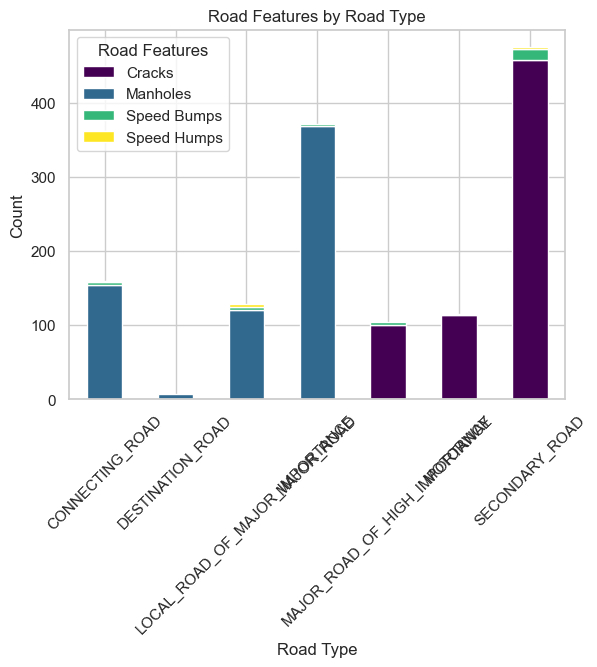

In [90]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame

# Pivot the data to create a DataFrame suitable for a stacked bar chart
pivot_data = g1.pivot(index='road_type', columns='road_feature', values='road_feature_Count')

# Create a stacked bar chart
plt.figure(figsize=(10, 6))

# Set the style
sns.set(style="whitegrid")

# Use seaborn's barplot to create a stacked bar chart
pivot_data.plot(kind='bar', stacked=True, colormap="viridis")

# Add labels and a legend
plt.xlabel('Road Type')
plt.ylabel('Count')
plt.title('Road Features by Road Type')

# Rotate the x-axis labels for better readability (if needed)
plt.xticks(rotation=45)

plt.legend(title='Road Features')

plt.show()
